# PROJECT OVERVIEW

James M. Irving, Ph.D.

Flatiron Full Time Data Science 021119 Cohort

https://mybinder.org/v2/gh/jirvingphd/bs_ds/master

# ABSTRACT:

> Stock Market prices are notoriously difficult to model, but advances in machine learning algorithms in recent years provide renewed possibilities in accurately modeling market performance. One notable addition in modern machine learning is that of Natural Language Processing (NLP). For those modeling a specific stock, performing NLP feature extraction and analysis on the collection of news headlines, shareholder documents, or social media postings that mention the company can provide additional information about the human/social elements to predicting market behaviors. These insights could not be captured by historical price data and technical indicators alone.

> President Donald J. Trump is one of the most prolific users of social media, specifically Twitter, using it as a direct messaging channel to his followers, avoiding the traditional filtering and restriction that normally controls the public influence of the President of the United States. An additional element of the presidency that Trump has avoided is that of financial transparency and divesting of assets. Historically, this is done in order to avoid conflicts of interest, apparent or actual. The president is also known to target companies directly with his Tweets, advocating for specific changes/decisions by the company, or simply airing his greivances. This leads to the natural question, how much influence *does* President Trump exert over the financial markets? 

> To explore this question, we built multiple types of models attempting to answer this question, using the S&P500 as our market index. First, we built a classification model to predict the change in stock price 60 mins after the tweet. We trained Word2Vec embeddings on President Trump's tweets since his election, which we used as the embedding layer for LSTM and GRU neural networks. 

> We next build a baseline time series regression model, using historical price data alone to predict price by trading-hour. We then built upon this, adding several technical indicators of market performance as additional features. 
Finally, we combined the predicitons of our classification model, as well as several other metrics about the tweets (sentiment scores, # of retweets/favorites, upper-to-lowercase ratio,etc.) to see if combining all of these sources of information could explain even more of the variance in stock market prices. 


## MAIN QUESTION:
> #### **Can the Twitter activity of Donald Trump explain fluctuations in the stock market?**

**We will use a combination of traditional stock market forecasting combined with Natural Language Processing and word embeddings from President Trump's tweets to predict fluctuations in the stock market (using S&P 500 as index).**

- **Question 1: Can we predict if stock prices will go up or down at a fixed time point, based on the language in Trump's tweets?**
    - [NLP Model 0](#Model-0)<br><br>
    
- **Question 2: How well can explain stock market fluctuations using only historical price data?**
    - [Stock Market Model 1](#Model-1:-Using-Price-as-only-feature)<br><br>
- **Question 3: Does adding technical market indicators to our model improve its ability to predict stock prices?**
    - [Stock Market Model 2](#Model-2:-Stock-Price-+-Technical-Indicators)<br><br>
- **Question 4: Can the NLP predictions from Question 1, combined with all of the features from Question 3, as well as additional information regarding Trump's Tweets explain even more of the stock market fluctuations?**
    - Stock Market Model 3
    - Stock Market Model X<br><br>

    
### REFERENCES / INSPIRATION:

1. **Stanford Scientific Poster Using NLP ALONE to predict if stock prices increase or decrease 5 mins after Trump tweets.**  
    - [Poster PDF LINK](http://cs229.stanford.edu/proj2017/final-posters/5140843.pdf)
    - Best accuracy was X, goal 1 is to create a classifier on a longer timescale with superior results.
    

2. **TowardsDataScience Blog Plost on "Using the latest advancements in deep learning to predict stock price movements."** 
     - [Blog Post link](https://towardsdatascience.com/aifortrading-2edd6fac689d)

## OVERVIEW OF DATA/FEATURES USED PER MODEL


#### TWITTER DATA - CLASSIFICATION MODEL
**Trained Word2Vec embeddings on collection of Donal Trump's Tweets.**
- Used negative skip-gram method and negative sampling to best represent infrequently used words.
    
**Classified tweets based on change in stock price (delta_price)**
- Calculated price change from time of tweet to 60 mins later.
    - "No Change" if the delta price was < \\$0.05 
    - "Increase" if delta price was >+\\$0.05
    - "Decrease if delta price was >-\\$0.05
    
*NOTE: This model's predictions will become a feature in our final model.*


#### STOCK MARKET (S&P 500) DATA :
##### TIME SERIES FORECASTING USING MARKET DATA
**Model 1: Use price alone to forecast hourly price.**
- Train model using time sequences of 7-trading-hours (1 day) to predict the following hour. 
    * [x] ~~SARIMAX model~~
    * [x] LSTM neural network 

**Model 2: Use price combined with technical indicators.**
    * LSTM neural network
- **Calculate 7 technical indicators from S&P 500 hourly closing price.**
    * [x] 7 days moving average 
    * [x] 21 days moving average
    * [x] exponential moving average
    * [x] momentum
    * [x] Bollinger bands
    * [x] MACD
    
  

#### FINAL MODEL: COMBINING STOCK MARKET DATA,  NLP CLASSIFICATION, AND OTHER TWEET METRICS
- **FEATURES FOR FINAL MODEL:**<br><br>
    - **Stock Data:**
        * [x] 7 days moving average 
        * [x] 21 days moving average
        * [x] exponential moving average
        * [x] momentum
        * [x] Bollinger bands
        * [x] MACD<br><br>
    - **Tweet Data:**
        * [x] 'delta_price' prediction classification for body of tweets from prior hour (model 0)
        * [x] Number of tweets in hour
        * [x] Ratio of uppercase:lowercase ratio (case_ratio)
        * [x] Total # of favorites for the tweets
        * [x] Total # of retweets for the tweets
        * [x] Sentiment Scores:
            - [x] Individual negative, neutral, and positive sentiment scores
            - [x] Compound Sentiment Score (combines all 3)
            - [x] sentiment class (+/- compound score)    

## OSEMN FRAMEWORK

### [OBTAIN](#OBTAIN)
- Obtaining 1-min resolution stock market data (S&P 500 Index)
- Obtain batch of historical tweets by President Trump 

### [SCRUB](#SCRUB)
1. **[Tweets](#TRUMP'S-TWEETS)**
    - Preprocessing for Natural Language Processing<br><br>
2. **[Stock Market](#Loading-&-Processing-Stock-Data-(SCRUB))**
    - Time frequency conversion
    - Technical Indicator Calculation

### [EXPLORE / VISUALIZE](#EXPLORE/VISUALIZE)
- [Tweet Delta Price Classes](#Delta-Price-Classes) 
- [NLP Figures / Example Tweets](#Natural-Language-Processing)
- [S&P 500 Price](#Model-1:-Using-Price-as-only-feature)
- [S&P 500 Technical Indicators](#Technical-Indicator-Details)

### [MODELING (Initial)](#INITIAL-MODELING)
- [Delta-Stock-Price NLP Classifier](#TWEET-DELTA-PRICE-CLASSIFICATON)
- [S&P 500 Neural Network (price only)] ( )

### iNTERPRETATION 
- Delta-Stock-Price NLP Models
    - Model 0A Summary
    - Model 0B Summary
    
- Stock-Market-Forecasting
    - Model 1 Summary
    - Model 2 Summary
    - Model 3 Summary
    - Model 4 Summary
- Final Summary

# OBTAIN

### DATA SOURCES:

* **All Donald Trump tweets from 12/01/2016 (pre-inaugaration day) to end of 08/23/2018**
    *          Extracted from http://www.trumptwitterarchive.com/

* **Minute-resolution data for the S&P500 covering the same time period.**
    *         IVE S&P500 Index from - http://www.kibot.com/free_historical_data.aspx
    - (Aggregate 1 min bid-ask data link)
    
    
* NOTE: Both sources required manual extraction and both 1-min historical stock data and batch-historical-tweet data are difficult to obtain without paying \\$150-\\$2000 monthly developer memberships. 

# SCRUB

In [16]:
# !pip install -U cufflinks

In [17]:
import os,sys
sys.path.append('py_files/')

## IMPORT MY PUBLISHED PYPI PACKAGE 
# import bs_ds as  bs
import bs_ds_local as bs
from fsds_100719.imports import *
# from bs_ds.imports import *

## IMPORT CUSTOM CAPSTONE FUNCTIONS
import functions_combined_BEST as ji
import functions_io as io

from functions_combined_BEST import ihelp, ihelp_menu,\
reload, inspect_variables

## IMPORT CONVENIENCE/DISPLAY FUNCTIONS
from pprint import pprint
import qgrid
import json
import ipywidgets as widgets

# Import plotly and cufflinks for iplots
import plotly
import cufflinks as cf
from plotly import graph_objs as go
from plotly.offline import iplot
cf.go_offline()

In [ ]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

#Set pd.set_options for tweet visibility
pd.set_option('display.max_colwidth',100)
pd.set_option('display.max_columns',50)

In [18]:
## Saving the sys.stdout to restore later
import sys
__stdout__=sys.stdout

file_dict = io.def_filename_dictionary(load_prior=False, save_directory=True)

------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

[i] filename_directory saved to data/filename_dictionary.json.
	 - use `update_file_directory(file_dict)` to update file.
[i] creating all required folders...


In [19]:
os.listdir()

['output_59_3.png',
 'output_60_7.png',
 'output_80_3.png',
 'py_files',
 'output_66_3.png',
 'output_38_0.png',
 'output_59_5.png',
 'output_66_7.png',
 '.DS_Store',
 'app2.py',
 'output_60_3.png',
 'Capstone_Adapted.ipynb',
 'Images',
 'readme_resources',
 'notebook_app.ipynb',
 'output_128_3.png',
 'keras_hyperparameter_tuning.ipynb',
 'models',
 'README.md',
 'output_122_3.png',
 'output_54_5.png',
 'results',
 'Capstone_Adapted-SG.ipynb',
 '.gitignore',
 'output_74_3.png',
 'output_33_1.png',
 'figures',
 'output_54_3.png',
 'output_94_3.png',
 '.gitattributes',
 '.ipynb_checkpoints',
 'output_32_0.png',
 'output_88_3.png',
 '.git',
 'Capstone_Adapted-SG-ONLY CODE.ipynb',
 'data',
 'assets',
 'output_36_0.png']

## TRUMP'S TWEETS

### Natural Language Processing Info



To prepare Donal Trump's tweets for modeling, **it is essential to preprocess the text** and simplify its contents.
<br><br>
1. **At a minimum, things like:**
    - punctuation
    - numbers
    - upper vs lowercase letters<br>
    ***must*** be addressed before any initial analyses. I refer tho this initial cleaning as **"minimal cleaning"** of the text content<br>
    
> Version 1 of the tweet processing removes these items, as well as the removal of any urls in a tweet. The resulting data column is referred to here as "content_min_clean".

<br><br>
2. It is **always recommended** that go a step beyond this and<br> remove **commonly used words that contain little information** <br>for our machine learning algorithms. Words like: (the,was,he,she, it,etc.)<br> are called **"stopwords"**, and it is critical to address them as well.

> Version 2 of the tweet processing removes these items and the resulting data column is referred here as `cleaned_stopped_content`

<br>

3. Additionally, many analyses **need the text tokenzied** into a list of words<br> and not in a natural sentence format. Instead, they are a list of words (**tokens**) separated by ",", which tells the algorithm what should be considered one word.<br><br>For the tweet processing, I used a version of tokenization, called `regexp_tokenziation` <br>which uses pattern of letters and symbols (the `expression`) <br>that indicate what combination of alpha numeric characters should be considered a single token.<br><br>The pattern I used was `"([a-zA-Z]+(?:'[a-z]+)?)"`, which allows for words such as "can't" that contain "'" in the middle of word. This processes was actually applied in order to process Version 1 and 2 of the Tweets, but the resulting text was put back into sentence form. 

> Version 3 of the tweets keeps the text in their regexp-tokenized form and is reffered to as `cleaned_stopped_tokens`
<br>

4. While not always required, it is often a good idea to reduce similar words down to a shared core.
There are often **multiple variants of the same word with the same/simiar meaning**,<br> but one may plural **(i.e. "democrat" and "democrats")**, or form of words is different **(i.e. run, running).**<br> Simplifying words down to the basic core word (or word *stem*) is referred to as **"stemming"**. <br><br> A more advanced form of this also understands things like words that are just in a **different tense** such as  i.e.  **"ran", "run", "running"**. This process is called  **"lemmatization**, where the words are reduced to their simplest form, called "**lemmas**"<br>  
> Version 4 of the tweets are all reduced down to their word lemmas, futher aiding the algorithm in learning the meaning of the texts.


### Tweet Processing

In [20]:
reload(ji)
func_list = [ji.load_raw_twitter_file,
           ji.make_stopwords_list,
           ji.full_twitter_df_processing,
           ji.full_sentiment_analysis]
ji.ihelp_menu(func_list)

# ji.save_ihelp_menu_to_file(func_list,filename='_twitter_processing')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

In [21]:
import os
os.listdir('data')

['filename_dictionary.json',
 'SP500_1min_01_23_2020.xlsx',
 'trump_tweets_12012016_to_01012020.csv',
 '_combined_stock_data_raw_tweets.csv',
 '_combined_stock_data_plus_nlp.csv',
 'SP500_1min_01_23_2020_full.xlsx',
 '_stock_df_with_technical_indicators.csv']

In [22]:
# from functions_combined_BEST import ihelp_menu2
# # file_dict = ji.load_filename_directory()
raw_tweets = 'data/trump_tweets_12012016_to_01012020.csv'
sp500 = 'data/SP500_1min_01_23_2020.xlsx'
# dft = pd.read_csv(tweets)
# dfs = pd.read_excel(sp500)
np.random.seed(42)

In [23]:
## Process twitter data: 

## Load in raw csv of twitter_data, create date_time_index, rename columns
# raw_tweets ='data/trump_tweets_12012016_to_01012020.csv'
twitter_df = ji.load_raw_twitter_file(filename=raw_tweets, 
                         date_as_index=True,
                         rename_map={'text': 'content',
                                     'created_at': 'date'})
twitter_df.head()

[io] Loading raw tweet text file: data/trump_tweets_12012016_to_01012020.csv


,source,content,date,retweet_count,favorite_count,is_retweet,id_str
date,,,,,,,
2020-01-01 03:12:07,Twitter Media Studio,https://t.co/EVAEYD1AgV,2020-01-01 03:12:07,25016,108830,False,1212209862094012416
2020-01-01 01:30:35,Twitter for iPhone,HAPPY NEW YEAR!,2020-01-01 01:30:35,85409,576045,False,1212184310389850119
2020-01-01 01:22:28,Twitter for iPhone,Our fantastic First Lady! https://t.co/6iswto4WDI,2020-01-01 01:22:28,27567,132633,False,1212182267113680896
2020-01-01 01:18:47,Twitter for iPhone,RT @DanScavino: https://t.co/CJRPySkF1Z,2020-01-01 01:18:47,10796,0,True,1212181341078458369
2020-01-01 01:17:43,Twitter for iPhone,RT @SenJohnKennedy: I think Speaker Pelosi is having 2nd thoughts about impeaching the President...,2020-01-01 01:17:43,8893,0,True,1212181071988703232


In [24]:
import cufflinks as cf
cf.go_offline()

In [25]:
# twitter_df.iplot(kind='bar')

### New - 09/26/19
- Like stanford poster, removing most common words


In [26]:
# import class_TextProcessor as tp
# reload(tp)
# TEXTS = tp.TextsProcessor(twitter_df,'content')
# # TEXTS.fit_FreqDist()

In [27]:
# TEXTS.update_stopwords_list(add_words=['rt','great','president','people','trump','country','news','realdonaldtrump'])
# TEXTS.fit_FreqDist()

In [28]:
# frequent_words = TEXTS.stopwords_list

In [29]:
# import nltk
# nltk.download('wordnet')
# nltk.download('vader_lexicon')

In [30]:
# 1. create minimally cleaned column `content_min_clean` with urls
twitter_df = ji.full_twitter_df_processing(twitter_df,
                                           raw_tweet_col='content',
                                           name_for_cleaned_tweet_col='content_cleaned',
                                           name_for_stopped_col='cleaned_stopped_content', 
                                           name_for_tokenzied_stopped_col='cleaned_stopped_tokens',
                                           use_col_for_case_ratio='content', 
                                           use_col_for_sentiment='content_min_clean',
                                           RT=True, urls=True, hashtags=True, mentions=True,
                                           str_tags_mentions=True,force=True)
#                                            stopwords_list=frequent_words, force=True)
#                                            stopwords_list=stop_words, force=True)
## Display Index information
ji.index_report(twitter_df,label='twitter_df')

## Check for strings that exceed the correct tweet length
keep_idx = ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,display_describe=False)
## verify no issues arise.
if keep_idx.isna().sum()>0:
    raise Exception('')
else:
    twitter_df=twitter_df[keep_idx]
    print(f'removed {np.sum(keep_idx==False)}')

ji.check_length_string_column(twitter_df, 'content_min_clean',length_cutoff=400,return_keep_idx=False)
twitter_df.head(2)

[i] case_ratio calculated from content before text to lowercase
[i] case->lower and punctuation removed from "content_min_clean" 
[i] stopped text column:  cleaned_stopped_content
[i] tokenized stopped text column:  cleaned_stopped_tokens
[i] lemmaztied columns: cleaned_stopped_lemmas
------------------------------------------------------------
	INDEX REPORT:	twitter_df
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2020-01-01 03:12:07
* Index Freq:
	None
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 2 # of strings above cutoff of 400 chars.
removed 2
------------------------------------------------------------
	STRING LENGTH REPORT:	"content_min_clean" column
------------------------------------------------------------
[i] Found 0 # of strings above cutoff of 400 chars.


,count,mean,std,min,25%,50%,75%,max
content_min_clean,14064,148.913,83.6571,0,96,127,229,310


,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos
date,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209
2016-12-01 14:38:09,Twitter for Android,Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,2016-12-01 14:38:09,9834,57249,False,804333771021570048,False,False,[],Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,getting ready to leave for the great state of indiana and meet the hard working and wonderful pe...,0.06034,[],,[],,getting ready leave great state indiana meet hard working wonderful people carrier c,"[getting, ready, leave, great, state, indiana, meet, hard, working, wonderful, people, carrier, c]",getting ready leave great state indiana meet hard working wonderful people carrier c,"{'neg': 0.093, 'neu': 0.538, 'pos': 0.369, 'compound': 0.8658}",0.8658,pos,0.093,0.538,0.369


### New - 09/21/19
- Removing 'starts_RT' tweets

In [31]:
display(twitter_df['is_retweet'].value_counts())

twitter_df = twitter_df.query('is_retweet == False')
display(twitter_df['is_retweet'].value_counts())

False    12339
True      1667
Name: is_retweet, dtype: int64

False    12339
Name: is_retweet, dtype: int64

In [32]:
# # Dropping columns about retweets
# drop_cols = ['has_RT','content_starts_RT','starts_RT']
# twitter_df.drop(drop_cols,axis=1,inplace=True)

In [33]:
from fsds_100719.imports import *
fs.ihelp(ji.display_same_tweet_diff_cols)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function display_same_tweet_diff_cols in module functions_combined_BEST:

display_same_tweet_diff_cols(df_sampled, index=None, columns=['content', 'content_min_clean', 'cleaned_stopped_content', 'cleaned_stopped_tokens', 'cleaned_stopped_lemmas'], as_df=False, as_md=True, time_format='%m-%d-%Y %T', for_dash=False)
    Displays the contents each column for a specific index = i; 
    If i=None then defaults to randomly selected row.

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def display_same_tweet_diff_cols(df_sampled,index=None,columns = ['content' ,'content_min_clean',
                                                                'cleaned_stopped_content',
                                                                'cleaned_stopped_tokens',
                                                                'cleaned_stopped_lemmas'],
                                                                 as_df = False, as_md=True,
                                                                 time_format='%m-%d-%Y %T',
                                                                 for_dash=False):
    """Displays the contents each column for a specific index = i; 
    If i=None then defaults to randomly selected row."""
    import pandas as pd
    import numpy as np
    from IPython.display import display, Markdown, HTML
    
    ## Check for provided i index, if None, then randomly select from provided df.index

    # check if i=str is
    if index is not None:
        if isinstance(index,str) and  check_if_str_is_date(index, fuzzy=True):
            try:
                # i = pd.to_datetime(index)
                i=index
                tweet = df_sampled.loc[i]
            except:
                print('ERROR')
                print(index,'. type= ',type(i))
                # else:
                #     raise Exception('string is not valid date index')

        elif isinstance(index, int):
            i = index
            tweet = df_sampled.iloc[i]

    else: #index is None:
        i = np.random.choice(df_sampled.index.to_series()) #range(len(df_sampled)))
        # print(i)
        tweet = df_sampled.loc[i]

    ## setup parameters to use if df or series
    if tweet.ndim==1: # if seires
        is_series =True
        num_tweets = 1
        # index_series = tweet.name
        print_index = [pd.to_datetime(tweet.name).strftime(time_format)]

    else: #if dataframe
        is_series=False
        num_tweets = tweet.shape[0]
        # Make the index a series
        index_series = tweet.index.to_series()
        # Make print-formmated list of indices
        print_index = list(index_series.apply(lambda x: x.strftime(time_format)))#'%m-%d-%Y %T')))
    
    
    if as_df == False and as_md==False:

        ## for each tweet:
        for i in range(num_tweets):

            print(f'\n>> TWEETED ON {print_index[i] }') ##tweet.index[i]}')
            if is_series:
                tweet_to_print = tweet
            else:
                tweet_to_print=tweet.loc[print_index[i]]

            # print each column for dataframes
            for col in columns:
                print(f"\n\t[col='{col}']:")
                # col_text = tweet.loc[col] 
                print('\t\t"',tweet_to_print[col],'"')

            if num_tweets>1:
                print('\n','---'*10)


    elif as_md:

        if for_dash==False:
            for ii in range(len(print_index)):#range(num_tweets):
                i = print_index[ii]
                tweet_to_print = df_sampled.loc[i]
            
                if num_tweets>1:
                    display(Markdown("<br>"))
                    display(Markdown(f'### Tweet #{ii+1} of {len(print_index)}: sent @ *{i}*:'))#index[i]
                else:
                    display(Markdown(f'#### TWEET FROM {i}:'))#index[i]
                # print(f'* TWEETED ON {df_sampled.index[i]}')
                for col in columns:

                    col_name = f'* **["{col}"] column:**<p><blockquote>***"{tweet_to_print[col]}"***'
                    
                    display(Markdown(col_name))
        else:
            markdown_list= []
            for ii in range(len(print_index)):#range(num_tweets):
                i = print_index[ii]
                tweet_to_print = df_sampled.loc[i]
            
                if num_tweets>1:
                    markdown_list.append(["\n"])
                    markdown_list.append([f'### Tweet #{ii+1} of {len(print_index)}: sent @ *{i}*:'])
                    # display(Markdown("<br>"))
                    # display(Markdown(f'### Tweet #{ii+1} of {len(print_index)}: sent @ *{i}*:'))#index[i]
                else:
                    markdown_list.append([f'#### TWEET FROM {i}:'])
                    # display(Markdown(f'#### TWEET FROM {i}:'))#index[i]
                # print(f'* TWEETED ON {df_sampled.index[i]}')
                for col in columns:

                    col_name = f'* **"{col}" column:**'
                    quote=f'> ***"{tweet_to_print[col]}"***'
                    markdown_list.append([col_name])
                    markdown_list.append([quote])
                    # display(Markdown(col_name))
            markdown_out = [' '.join(x) for x in markdown_list]
            markdown_out = '\n'.join(markdown_out)
            return markdown_out
            
    elif as_df:

        # for i in range(num_tweets):
        for ii in range(len(print_index)):#range(num_tweets):
            i = print_index[ii]
            tweet_to_print = df_sampled.loc[i]

            df = pd.DataFrame(columns=['tweet'],index=columns)
            df.index.name = 'column'
            for col in columns:
                df['tweet'].loc[col] = tweet_to_print[col]#[i]
            
            with pd.option_context('display.max_colwidth',0, 'display.colheader_justify','left'):#,'colheader_justify','left'):
                # caption = f'Tweet #{ii+1}  = {i}'
                capt_text  = f'Tweet #{ii+1} of {len(print_index)}: sent @ *{i}*:'
                table_style =[{'selector':'caption',
                'props':[('font-size','1.2em'),('color','darkblue'),('font-weight','bold'),
                ('vertical-align','0%')]}]
                dfs = df.style.set_caption(capt_text).set_properties(subset=['tweet'],
                **{'width':'600px',
                'text-align':'center',
                'padding':'1em',
                'font-size':'1.2em'}).set_table_styles(table_style)
                display(dfs)
    return 

```

In [34]:
ji.display_same_tweet_diff_cols(twitter_df)

#### TWEET FROM 05-15-2019 18:20:30:

* **["content"] column:**<p><blockquote>***"The courage &amp; sacrifice of our heroes is the reason our flag stands tall our hearts beat with pride and our Country remains one people one family and one NATION UNDER GOD. Today we thank you we honor you &amp; we forever cherish the memory of our Fallen Men and Women in Blue! https://t.co/ARHYgDVi3M"***

* **["content_min_clean"] column:**<p><blockquote>***"the courage  amp  sacrifice of our heroes is the reason our flag stands tall our hearts beat with pride and our country remains one people one family and one nation under god  today we thank you we honor you  amp  we forever cherish the memory of our fallen men and women in blue  "***

* **["cleaned_stopped_content"] column:**<p><blockquote>***"courage sacrifice heroes reason flag stands tall hearts beat pride country remains one people one family one nation god today thank honor forever cherish memory fallen men women blue"***

* **["cleaned_stopped_tokens"] column:**<p><blockquote>***"['courage', 'sacrifice', 'heroes', 'reason', 'flag', 'stands', 'tall', 'hearts', 'beat', 'pride', 'country', 'remains', 'one', 'people', 'one', 'family', 'one', 'nation', 'god', 'today', 'thank', 'honor', 'forever', 'cherish', 'memory', 'fallen', 'men', 'women', 'blue']"***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"courage sacrifice hero reason flag stand tall heart beat pride country remains one people one family one nation god today thank honor forever cherish memory fallen men woman blue"***

In [35]:
## Search all tweets for occurances of specific words
word = 'fed'
idx_russia_tweets = ji.search_for_tweets_with_word(twitter_df, word =word,
                                     display_n=5, from_column='content',
                                     return_index=True, display_df=True)

date,content,retweet_count,favorite_count,source,compound_score,sentiment_class
2019-12-25 22:29:29,Governor Gavin N has done a really bad job on taking care of the homeless population in California. If he can’t fix the problem the Federal Govt. will get involved! https://t.co/2z8zM37PUA,23298,91597,Twitter for iPhone,-0.5095,neg
2019-12-24 22:32:38,187 new Federal Judges have been confirmed under the Trump Administration including two great new United States Supreme Court Justices. We are shattering every record! Read all about this in “The Long Game” a great new book by @senatemajldr Mitch McConnell. Amazing story!,25846,115013,Twitter for iPhone,0.936,pos
2019-12-21 03:02:54,To Our Incredible Federal Workforce: https://t.co/zIyXW834H5,9547,39513,Twitter for iPhone,0,pos
2019-12-17 15:12:35,Would be sooo great if the Fed would further lower interest rates and quantitative ease. The Dollar is very strong against other currencies and there is almost no inflation. This is the time to do it. Exports would zoom!,20609,88087,Twitter for iPhone,0.8775,pos
2019-12-14 14:25:38,“Independent voters are fed up and frustrated with the Democrats.” Congressman Michael Waltz Florida,14688,68868,Twitter for iPhone,-0.5267,neg


	 * there are 231 tweets not shown. Next index = 2019-12-02 21:19:46


### Calculating `delta_price_class` for Each Tweet
#### Using S&P 500 Price  1-min-resolution for `delta_price`

In [36]:
func_list = [ji.load_raw_stock_data_from_txt, 
            ji.set_timeindex_freq,
            ji.load_twitter_df_stock_price]

ji.ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_stock_data_to_twitter_data')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_ra…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_data_to_twitter_data.md


#### Add Delta Stock Price Data - For *Each* Tweet

In [37]:

ji.column_report(twitter_df,as_qgrid=False,as_df=True)

,column name,dtypes,# zeros,# null,% null,Notes
".iloc[:,i]",,,,,,
0,source,object,0.0,0,0.0,
1,content,object,0.0,0,0.0,
2,date,datetime64[ns],0.0,0,0.0,
3,retweet_count,int64,0.0,0,0.0,
4,favorite_count,int64,2131.0,0,0.0,
5,is_retweet,object,12339.0,0,0.0,
6,id_str,int64,0.0,0,0.0,
7,has_RT,bool,10126.0,0,0.0,
8,starts_RT,bool,10210.0,0,0.0,


In [38]:
print(f"[i] # number of tweets = {twitter_df.shape[0]}")

## add stock_price for twitter_df
null_ratio = ji.check_null_small(twitter_df,null_index_column='case_ratio')

print(f'[!] {len(null_ratio)} null values for "case_ratio" are tweets containing only urls. Dropping...')
twitter_df.dropna(subset=['is_retweet','case_ratio'],inplace=True)
print(f"[i] New # of tweets = {twitter_df.shape[0]}\n")

[i] # number of tweets = 12339


------------------------------
Columns with Null Values
------------------------------
Series([], dtype: int64)


[!] 0 null values for "case_ratio" are tweets containing only urls. Dropping...
[i] New # of tweets = 12339



In [39]:
reload(ji)
# stock_df = pd.read_excel('data/SP500_1min_01_23_2020.xlsx')
stock_df = pd.read_excel('data/SP500_1min_01_23_2020.xlsx',parse_dates=False)
stock_df.head()

,Date,Time,BidOpen,BidHigh,BidLow,BidClose,AskOpen,AskHigh,AskLow,AskClose
0,2016-01-04,09:30:00,79.18,79.37,79.18,79.23,79.41,79.42,79.28,79.28
1,2016-01-04,09:31:00,79.20,79.26,79.20,79.25,79.26,79.29,79.25,79.29
2,2016-01-04,09:32:00,79.26,79.26,79.26,79.26,79.33,79.33,79.33,79.33
3,2016-01-04,09:33:00,79.23,79.23,79.21,79.21,79.29,79.29,79.25,79.25
4,2016-01-04,09:34:00,79.13,79.13,79.13,79.13,79.15,79.16,79.15,79.16


In [40]:
date_time_index = stock_df["Date"].astype('str') + ' '+stock_df['Time'].astype('str')
stock_df['date_time_index'] = pd.to_datetime(date_time_index)

In [41]:
# date_time_index = (stock_df['Date'].astype('str')+' '+stock_df['Time'])#.rename('date_time_index')
# date_time_index

In [42]:
twitter_df = ji.load_twitter_df_stock_price(twitter_df, 
                                            stock_price_file='data/SP500_1min_01_23_2020.xlsx',
                                           get_stock_prices_per_tweet=True,
                                           price_mins_after_tweet=60)

ji.index_report(twitter_df);

[io] Loading 1-minute-resolution stock_prices...
[i] Adding stock_price data for 60 mins post-tweets using `get_stock_prices_for_twitter_data`...
[i] Limiting twitter_df timeindex to match stock_price.
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 14:37:57 -- to -- 2020-01-01 03:12:07
* Index Freq:
	None


In [43]:
idx_null_delta = ji.check_null_small(twitter_df,null_index_column='delta_price');
print(f"[!] {len(idx_null_delta)} null values for 'delta_price' were off-hour tweets,\
more than 1 day before the market reopened. Dropping...")
twitter_df.dropna(subset=['delta_price'], inplace=True)

print(f"\n[i] Final # of tweets = {twitter_df.shape[0]}")



------------------------------
Columns with Null Values
------------------------------
stock_price_results    3020
B_ts_rounded           3020
pre_tweet_price        3020
mins_after_tweet       3020
B_ts_post_tweet        3020
post_tweet_price       3020
delta_time             3020
delta_price            3020
dtype: int64


[!] 3020 null values for 'delta_price' were off-hour tweets,more than 1 day before the market reopened. Dropping...

[i] Final # of tweets = 9319


In [44]:
# ji.column_report(twitter_df, as_df=True)

### Determining Cutoffs for Delta Price Classes

In [45]:
## Examine delta_price
print("CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:")
print(twitter_df['delta_price_class'].value_counts())

## Examining Changes to classes if use a "No Change" cutoff of $0.05
delta_price = twitter_df['delta_price']
small_pos =[ 0 < x <.05 for x in delta_price] #/len(delta_price)
small_neg = [-.05<x <0 for x in delta_price]

print('\nCHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:\n','---'*12)
print(f'# Positive Delta -> "No Change" = {np.sum(small_pos)}')
print(f'# Negative Delta -> "No Change" = {np.sum(small_neg)}')
print(f'# of Unchanged Classifications =  {len(delta_price)-(np.sum(small_pos)+np.sum(small_neg))}')

CURRENT # OF POSTITIVE AND NEGATIVE PRICE DELTAS:
pos    5514
neg    3805
Name: delta_price_class, dtype: int64

CHANGES TO CLASSES IF USING ATHRESHOLD OF $0.05:
 ------------------------------------
# Positive Delta -> "No Change" = 670
# Negative Delta -> "No Change" = 822
# of Unchanged Classifications =  7827


In [46]:
## BIN DELTA PRICE CLASS
bins = pd.IntervalIndex.from_tuples([ (-np.inf,-.05), (-.05,.05), (.05,np.inf)], closed='left')
## Save indexer column for 'delta_price'
twitter_df['indexer'] = bins.get_indexer(twitter_df['delta_price'])

# remap -1,0,1,2 to classes
mapper ={-1:np.nan, 0:0, 1:1,2:2}
# remap string classes
mapper2 = {0:'neg', 1:'no_change',2:'pos'}

## Use indexer to map new integer values
twitter_df['delta_price_class_int']= twitter_df['indexer'].apply(lambda x: mapper[x])
twitter_df['delta_price_class'] = twitter_df['delta_price_class_int'].apply(lambda x: mapper2[x])

## Verify mapping of string and integer classes
res1 = pd.DataFrame(twitter_df['delta_price_class'].value_counts())
res2 = pd.DataFrame(twitter_df['delta_price_class_int'].value_counts())
bs.display_side_by_side(res1,res2)

,delta_price_class
pos,4844
neg,2860
no_change,1615
,delta_price_class_int
2,4844
0,2860
1,1615


## EXPLORE/VISUALIZE 
### Delta Price Classes

In [47]:
twitter_df.to_csv('data/_twitter_df_with_stock_price.csv')

In [35]:
ji.plotly_price_histogram(twitter_df,show_fig=True,as_figure=False)
ji.plotly_pie_chart(twitter_df, column_to_plot='delta_price_class',show_fig=True, as_figure=False)

### NLP by Delta Price Class

- For comparison of words and bigrams, we will exclude the 'no change' class. 

In [36]:
# twitter_df['delta_price_class']
bs.check_null_small(twitter_df)



------------------------------
Columns with Null Values
------------------------------
Series([], dtype: int64)




In [37]:
nlp_df = twitter_df.loc[twitter_df['delta_price_class']!='no_change'].copy()
# nlp_df.dropna(inplace=True)
nlp_df.head(2)

,source,content,date,retweet_count,favorite_count,is_retweet,id_str,has_RT,starts_RT,content_starts_RT,content_cleaned,content_min_clean,case_ratio,content_hashtags,hashtag_strings,content_mentions,mention_strings,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,sentiment_scores,compound_score,sentiment_class,neg,neu,pos,day,time,dayofweek,B_day,B_shifted,B_time,B_dt_index,time_shift,B_dt_minutes,stock_price_results,null_results,B_ts_rounded,pre_tweet_price,mins_after_tweet,B_ts_post_tweet,post_tweet_price,delta_time,delta_price,delta_price_class,delta_price_class_int,indexer
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2016-12-01 14:37:57,Twitter for iPhone,My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,2016-12-01 14:37:57,12077,65724,False,804333718999539712,False,False,[],My thoughts and prayers are with those affected by the tragic storms and tornadoes in the Southe...,my thoughts and prayers are with those affected by the tragic storms and tornadoes in the southe...,0.03906,[],,[],,thoughts prayers affected tragic storms tornadoes southeastern united states stay safe,"[thoughts, prayers, affected, tragic, storms, tornadoes, southeastern, united, states, stay, safe]",thought prayer affected tragic storm tornado southeastern united state stay safe,"{'neg': 0.168, 'neu': 0.623, 'pos': 0.209, 'compound': 0.2732}",0.2732,pos,0.168,0.623,0.209,2016-12-01,14:37:57,Thursday,2016-12-01,False,14:37:57,2016-12-01 14:37:57,0 days,2016-12-01 14:38:00,"{'B_ts_rounded': 2016-12-01 14:38:00, 'pre_tweet_price': 92.34, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-01 14:38:00,92.34,60.0,2016-12-01 15:38:00,92.19,01:00:00,-0.15,neg,0,0
2016-12-01 14:38:09,Twitter for Android,Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,2016-12-01 14:38:09,9834,57249,False,804333771021570048,False,False,[],Getting ready to leave for the Great State of Indiana and meet the hard working and wonderful pe...,getting ready to leave for the great state of indiana and meet the hard working and wonderful pe...,0.06034,[],,[],,getting ready leave great state indiana meet hard working wonderful people carrier c,"[getting, ready, leave, great, state, indiana, meet, hard, working, wonderful, people, carrier, c]",getting ready leave great state indiana meet hard working wonderful people carrier c,"{'neg': 0.093, 'neu': 0.538, 'pos': 0.369, 'compound': 0.8658}",0.8658,pos,0.093,0.538,0.369,2016-12-01,14:38:09,Thursday,2016-12-01,False,14:38:09,2016-12-01 14:38:09,0 days,2016-12-01 14:38:00,"{'B_ts_rounded': 2016-12-01 14:38:00, 'pre_tweet_price': 92.34, 'mins_after_tweet': 60, 'B_ts_po...",False,2016-12-01 14:38:00,92.34,60.0,2016-12-01 15:38:00,92.19,01:00:00,-0.15,neg,0,0


In [135]:
fs.ihelp(ji.compare_word_clouds,0)

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def compare_word_clouds(text1,label1,text2,label2,suptitle_text='', wordcloud_cfg_dict=None, twitter_shaped=True,from_freq_dicts=False,
fig_size = (18,18), subplot_titles_y_loc = 0, suptitle_y_loc=0.8, save_file=False,base_folder='figures/',png_name_from_title=False, png_filename=None,verbose=1,**kwargs):
    """Compares the wordclouds from 2 sets of texts. 
    text1,text2:
        If `from_freq_dicts`=False, texts must be non-tokenized form bodies of text.
        If `from_freq_dicts`=True, texts must be a frequency dictionary with keys=words, value=count
    
    label1,label2:
        string names/labels for the resulting wordcloud subplot titles
    
    cfg_dict:
        a dictionary with altnerative parameters for creation of WordClouds
        defaults are :
                {'max_font_size':100, 'width':400, 'height':400,
                'max_words':150, 'background_color':'white', 
                'cloud_stopwords':make_stopwords_list(),
                'collocations':False, 'contour_color':'cornflowerblue', 'contour_width':2}

    twitter_shaped:
        if true, local images of twitter logo will be used as a mask for the shape of the generated wordclouds. 
        if false, wordclouds will be rectangular (shape=specified 'width' and 'height' config keys)

    save_file:
        if True, saves .png to png_filename using suptitle as name (if given), else filename='wordcloud_figure.png'

    **kwargs:

        valid keywords: 
        - 'subplot_titles_fontdict':{any_matplotlib_text_kwds:values} # for ax.set_title() # passed as fontdict=fontdict
        - 'suptitle_fontdict':{any_matplotlib_text_kwds:values} # fontdict for plt.suptitle() # passed as **fontdict 
        - 'imshow':{'interpolation': #options are ['none', 'nearest', 'bilinear', 'bicubic', 'spline16',
                    'spline36', 'hanning', 'hamming', 'hermite', 'kaiser', 'quadric', 'catrom',
                     'gaussian', 'bessel', 'mitchell', 'sinc', 'lanczos'] }
        - 'group colors':('green','red)

        """
    import functions_combined_BEST as ji
    from wordcloud import WordCloud
    import matplotlib.pyplot as plt
    from PIL import Image
    import numpy as np
    from pprint import pprint as pp
    ## Fill in params dictionary with defaults
    # params= {}
    # params['subplot_titles_fontdict'] = {'fontsize':30}
    # params['suptitle_fontdict'] = {'fontsize':40}
    # params['imshow']= {'interpolation':'gaussian'}

    # ## Check for kwargs replacements to defaults
    # to_do = ['subplot_titles_fontdict','suptitle_fontdict','imshow']
    # for td in to_do:
    #     if td in kwargs and kwargs[td] is not None:
    #         params[td] = kwargs[td]
    
    ## Fill in params dictionary with defaults
    params= {}
    params['subplot_titles_fontdict'] = {'fontsize':30}
    params['suptitle_fontdict'] = {'fontsize':40}
    params['imshow']= {'interpolation':'gaussian'}
    params['group_colors']={'group1':'cornflowerblue','group2':'cornflowerblue'}

    ## Check for kwargs replacements to defaults
    to_do = ['subplot_titles_fontdict','suptitle_fontdict','imshow','group_colors']
    for td in to_do:
        if td in kwargs.keys() and kwargs[td] is not None:
            params[td] = kwargs[td]

    
    ## Handle word2vec_doict
    default_cfg={
                'max_font_size':100, 'width':400, 'height':400,
                'max_words':150, 'background_color':'white', 
                'cloud_stopwords':make_stopwords_list(),
                'collocations':False, 
                'contour_color':'cornflowerblue',
                'contour_width':2
                }
    cfg=default_cfg

    ## Use default config if none provided
    if wordcloud_cfg_dict is None:
        cfg = default_cfg
        if verbose==1: 
            print('Using default cfg. (use verbose=2 for details).')
        elif verbose>1:
            print('cfg kwargs:')
            pp(cfg)
        

    else:
        to_do = list(default_cfg.keys()) #['subplot_titles_fontdict','suptitle_fontdict','imshow']
        for td in to_do:
            if td in wordcloud_cfg_dict.keys() and wordcloud_cfg_dict[td] is not None:
                cfg[td] = wordcloud_cfg_dict[td]

        if verbose>1:
            print('cfg kwargs:')
            pp(cfg)

    ## Set different colors if group_colors specified
    if 'group_colors' in kwargs.keys():
        contour_color_1 = kwargs['group_colors']['group1']
        contour_color_2 = kwargs['group_colors']['group2']

    else: #otherwise use  word2vec cfg 
        contour_color_1 = cfg['contour_color']
        contour_color_2 = cfg['contour_color']

    # instantiate the two word clouds using cfg dictionary parametrs
    wordcloud1 = WordCloud(max_font_size = cfg['max_font_size'], width=cfg['width'], height=cfg['height'], max_words=cfg['max_words'],
    background_color=cfg['background_color'], stopwords=cfg['cloud_stopwords'],collocations=cfg['collocations'],
    contour_color=contour_color_1, contour_width=cfg['contour_width'])


    wordcloud2 = WordCloud(max_font_size = cfg['max_font_size'], width=cfg['width'], height=cfg['height'], max_words=cfg['max_words'],
    background_color=cfg['background_color'], stopwords=cfg['cloud_stopwords'],collocations=cfg['collocations'], 
    contour_color=contour_color_2, contour_width=cfg['contour_width'])

    ## Add .mask attribute to wordclouds if twitter_shaped==True
    if twitter_shaped ==True:
        ## Twitter Bird masks
        mask_f_right = np.array(Image.open('figures/masks/twitter1.png'))
        mask_f_left = np.array(Image.open('figures/masks/twitter1flip.png'))
        
        ## Assign the images to text1 and text2
        mask1=mask_f_right
        mask2=mask_f_left

        # Hashtag and mentions mask 
        # mask_at = np.array(Image.open('figures/masks/Hashtags and Ats Masks-04.jpg'))
        # mask_hashtag = np.array(Image.open('figures/masks/Hashtags and Ats Masks-03.jpg'))

        wordcloud1.mask=mask1
        wordcloud2.mask=mask2


    ## Fit wordclouds to text
    if from_freq_dicts==False:
        wordcloud1.generate(text1)                                          
        wordcloud2.generate(text2)
    
    elif from_freq_dicts==True:
        wordcloud1.generate_from_frequencies(text1)
        wordcloud2.generate_from_frequencies(text2)


    ## PLOTTING THE WORDCLOUDS

    # ## Fill in params dictionary with defaults
    # params= {}
    # params['subplot_titles_fontdict'] = {'fontsize':30}
    # params['suptitle_fontdict'] = {'fontsize':40}
    # params['imshow']= {'interpolation':'gaussian'}
    # params['group_colors':('green','red')]

    # ## Check for kwargs replacements to defaults
    # to_do = ['subplot_titles_fontdict','suptitle_fontdict','imshow','group_colors']
    # for td in to_do:
    #     if td in kwargs and kwargs[td] is not None:
    #         params[td] = kwargs[td]

    
    ## CREATE SUBPLOTS
    import matplotlib.pyplot as plt
    fig,ax = plt.subplots(nrows=1,ncols=2,figsize=fig_size)
    fig.suptitle(suptitle_text,y=suptitle_y_loc,**params['suptitle_fontdict'])

    ## Left Subplot  
    ax[0].imshow(wordcloud1, interpolation=params['imshow']['interpolation'])
    ax[0].axis("off")
    ax[0].set_title(label1, y=subplot_titles_y_loc,fontdict=params['subplot_titles_fontdict'] )

    ## Right Subplot
    ax[1].imshow(wordcloud2, interpolation=params['imshow']['interpolation'])
    ax[1].axis("off")
    ax[1].set_title(label2, y=subplot_titles_y_loc,fontdict=params['subplot_titles_fontdict'] )

    plt.tight_layout()
    plt.show()

    if save_file:

        # if name provided
        if png_filename is not None:

            #if base_folder is provided, check of overlaps
            if base_folder is not None:
                # if the folder is already in png_filename, use png_filename
                if base_folder in png_filename:
                    filename = png_filename

                else: # add base_folder to 
                    filename = base_folder+png_filename

        elif png_filename is None:

            if png_name_from_title:
                if len(suptitle_text)>0:
                    
                    title_for_filename = ji.replace_bad_filename_chars(suptitle_text,replace_spaces=False, replace_with='_')

                    if base_folder is not None:
                        filename = base_folder + title_for_filename+'.png'
                    else:
                        filename =title_for_filename+'.png'
                
            else:
                if base_folder is None:
                    base_folder=''
                prefix= base_folder+"wordcloud_figure"
                filename = ji.auto_filename_time(prefix=prefix)
                filename+='.png'

        fig.savefig(filename,facecolor=cfg['background_color'], format='png', frameon=True)
        print(f'figured saved as {filename}')

    return fig, ax

```

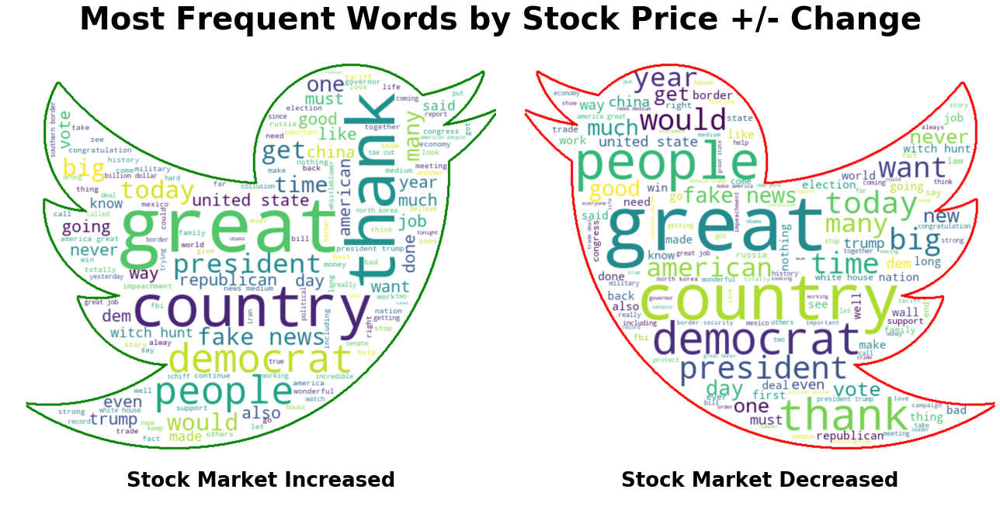

figured saved as figures/wordcloud_figure  02-27-2020 11-47-03.png


In [38]:
# Generate wordclouds
twitter_df_groups,twitter_group_text = ji.get_group_texts_for_word_cloud(nlp_df, 
                                                                      text_column='cleaned_stopped_lemmas', 
                                                                      groupby_column='delta_price_class')


ji.compare_word_clouds(text1=twitter_df_groups['pos']['joined'],
                       label1='Stock Market Increased',
                       text2= twitter_df_groups['neg']['joined'],
                       label2='Stock Market Decreased',
                       twitter_shaped = True, verbose=1,
                       suptitle_y_loc=0.75,
                       suptitle_text='Most Frequent Words by Stock Price +/- Change',
                       wordcloud_cfg_dict={'collocations':True},
                       save_file=True,filepath_folder='',
#                        png_filename=file_dict['nlp_figures']['word_clouds_compare'],
                      **{'subplot_titles_fontdict':{'fontsize':26,'fontweight':'bold'},
                        'suptitle_fontdict':{'fontsize':40,'fontweight':'bold'},
                         'group_colors':{'group1':'green','group2':'red'},
                        });

Unique Text1 Words,Frequency
shifty,25
bank,22
bishop,13
project,11
impeaching,10
mitt,10
church,10
singapore,9
anchor,9
shame,9


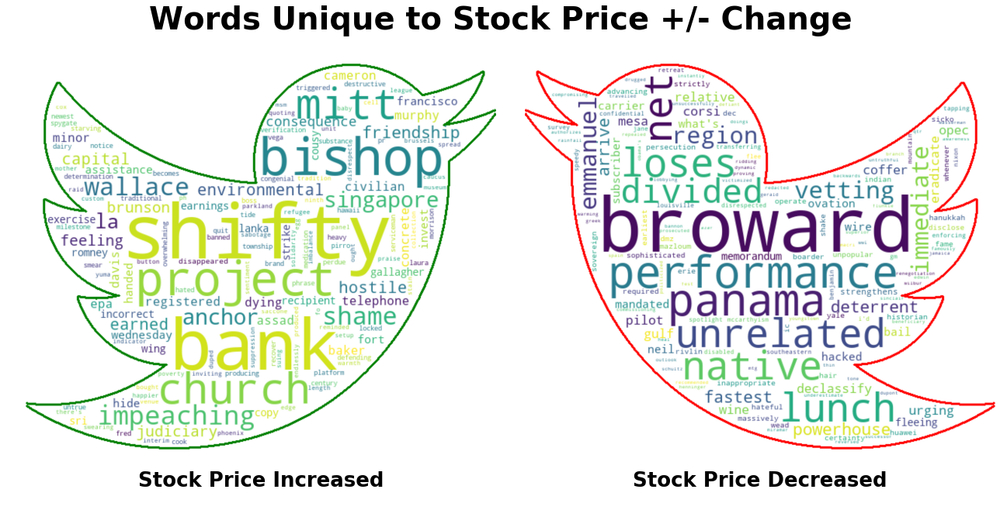

figured saved as figures/wordcloud_figure  02-27-2020 11-47-05.png


In [39]:
## Comparing words ONLY unique to each group
df_pos_words, df_neg_words = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=True,
                                                                return_as_dicts=False)

pos_freq_dict, neg_freq_dict = ji.compare_freq_dists_unique_words(text1=twitter_df_groups['pos']['text_tokens'],
                                                                label1='Price Increased',
                                                                text2=twitter_df_groups['neg']['text_tokens'],
                                                                label2='Price Decreased',
                                                                top_n=20, display_dfs=False,
                                                                return_as_dicts=True)


## WORDCLOUD OF WORDS UNIQUE TO TWEETS THAT INCREASED VS DECREASED STOCK PRICE
ji.compare_word_clouds(text1= pos_freq_dict,label1='Stock Price Increased',
                       text2=neg_freq_dict, label2='Stock Price Decreased',
                       twitter_shaped=True, from_freq_dicts=True,
                       suptitle_y_loc=0.75,wordcloud_cfg_dict={'collocations':True},
                       suptitle_text='Words Unique to Stock Price +/- Change',
                       save_file=True,filepath_folder='',
#                        png_filename=file_dict['nlp_figures']['word_clouds_compare_unique'],
                       **{'subplot_titles_fontdict':
                         {'fontsize':26,
                         'fontweight':'bold'},
                        'suptitle_fontdict':{
                         'fontsize':40,
                         'fontweight':'bold'},
                         'group_colors':{
                             'group1':'green','group2':'red'}
                        });

In [40]:
ji.make_tweet_bigrams_by_group(twitter_df_groups)

,Frequency
Bigram,
fake news,0.00303572
united states,0.00247264
witch hunt,0.00173819
white house,0.0014689
president trump,0.00129752
america great,0.00122408
border security,0.00107719
north korea,0.00107719
great job,0.00102823


# INITIAL MODELING

## TWEET DELTA PRICE CLASSIFICATON

### Creating Word Embeddings with Word2Vec

- Good Parameters for Non-Retweets:
```python
params = {
'text_column': 'cleaned_stopped_lemmas',
'window':3,
'min_count':2,
'epochs':10,
'sg':1, 
'hs':0,
'negative':5,
'ns_exponent':-0.5
}
```

In [41]:
func_list = [ji.make_word2vec_model,ji.get_wv_from_word2vec]#,
            #ji.get_w2v_kwargs,ji.Word2vecParams]
ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_word2vec')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('make_wo…

Output()

Functions saved as readme_resources/ihelp_outputs/_word2vec.md


In [42]:
## Loading custom class for tracking Word2Vec parameters
w2vParams = ji.Word2vecParams()        
w2vParams.params_template()

[i] call .params_template() for dict to copy/pate.
#TEMPLATE(call.show_info() for details:

        w2vparams = {
        'text_column': 'cleaned_stopped_lemmas',
        'window':3-5,
        'min_count':1-3,
        'epochs':10-20,
        'sg':0 or 1, 
        'hs':'0 or 1,
        'negative': 0 or 5-20 ,
        'ns_exponent':-1.0 to 1.0
        }


In [43]:
reload(ji,bs)

Reloading functions_combined_BEST...


In [44]:
## FITING WORD2VEC AND TOKENIZER    
model_kwds = {
# 'text_column': 'cleaned_stopped_lemmas',
'window':3,
'min_count':2,
'epochs':10,
'sg':1, 
'hs':0,
'negative':5,
'ns_exponent':-0.5
}
# model_kwds=  ji.get_w2v_kwargs(params)    

# text_data = twitter_df[params['text_column']]
## using df_tokenize for full body of a text for word2vec
word2vec_model = ji.make_word2vec_model(twitter_df,
                                        text_column = 'cleaned_stopped_lemmas',
                                        verbose=1,
                                        return_full=True,
                                        **model_kwds)

# w2vParams.append(params)

wv = word2vec_model.wv

### USING WORD VECTOR MATH TO GET A FEEL FOR QUALITY OF MODEL
wv = word2vec_model.wv
def V(string,wv=wv):
    return wv.get_vector(string)
def equals(vector,wv=wv):
    return wv.similar_by_vector(vector)

list_of_equations = ["V('republican')-V('honor')",
                    "V('man')+V('power')",
                     "V('russia')+V('honor')",
                     "V('china')+V('tariff')",
                     "V('flip')+V('lie')"]

for eqn in list_of_equations:
    print(f'\n* {eqn} =')
    res = eval(f"equals({eqn})")
    [print('\t',x) for x in res]

[i] Training Word2Vec model using:
	{'min_count': 2, 'window': 3, 'epochs': 10, 'sg': 1, 'hs': 0, 'negative': 5}
	[i] Training complete. model vocab has 5978 words, with vector size 300.
	[o] returned model is full model.

* V('republican')-V('honor') =
	 ('republican', 0.6008737087249756)
	 ('obstruct', 0.41857653856277466)
	 ('dem', 0.36922305822372437)
	 ('resist', 0.3675122857093811)
	 ("can't", 0.3557479977607727)
	 ('easily', 0.3500577509403229)
	 ('anyway', 0.3352363705635071)
	 ('rid', 0.32564932107925415)
	 ('either', 0.32010334730148315)
	 ('bernie', 0.3190964162349701)

* V('man')+V('power') =
	 ('man', 0.8018854260444641)
	 ('missed', 0.7978706359863281)
	 ('seeking', 0.7929173707962036)
	 ('marcus', 0.7910425662994385)
	 ('sir', 0.7899917364120483)
	 ('destroying', 0.789475679397583)
	 ('hatred', 0.7883740067481995)
	 ('edwin', 0.7882434129714966)
	 ('baby', 0.779895007610321)
	 ('stellar', 0.7798680663108826)

* V('russia')+V('honor') =
	 ('marcelo', 0.7920164465904236)
	

In [45]:
# import functions_io as io
# io.save_word2vec(word2vec_model,file_dict,parms_dict=w2vParams.last_params)



### Using Pre-Trained GloVe Twitter Vectors 
- 02-27-20 Moved to modeling section due to X_train requirement

#### Comparing Word Math W2V vs Glove

- Pre-Trained GloVe Twitter download http://nlp.stanford.edu/data/glove.twitter.27B.zip

In [46]:
## Save Glove Twitter Vectors to A Glove File For Word Math
folder_for_vectors ='/Users/jamesirving/Datasets/glove.twitter.27B/'
glove_file = 'glove.twitter.27B.100d.txt'

# # define full input glove and output word2vec filepaths
# glove_filepath = folder_for_vectors+glove_file
# w2v_filepath = folder_for_vectors+'glove_to_w2vec.txt'
# print(w2v_filepath)
# print(glove_filepath)

# ## Load in saved glove vectors using KeyedVectors.load_word2vec_format()
# from gensim.models import Word2Vec, KeyedVectors
# from gensim.scripts.glove2word2vec import glove2word2vec
# glove2word2vec(glove_filepath,w2v_filepath)
# glovew2v_model = KeyedVectors.load_word2vec_format(w2v_filepath)
# wvg = glovew2v_model.wv

In [47]:
# def V(string,wv=wvg):
#     return wv.get_vector(string)

# def equals(vector,wv=wvg):
#     return wv.similar_by_vector(vector)

# list_of_equations = ["V('republican')-V('honor')",
#                     "V('man')+V('power')",
#                      "V('russia')+V('honor')",
#                      "V('china')+V('tariff')",
#                      "V('trump')+V('lie')"]

# for eqn in list_of_equations:
#     print(f'\n* {eqn} =')
#     res = eval(f"equals({eqn})")
#     [print('\t',x) for x in res]

### Class Balancing

In [48]:
## Select smaller subset of twitter_df for df_tokenize
columns_for_model_0 = ['delta_price_class','delta_price','pre_tweet_price',
                       'post_tweet_price','delta_time','B_ts_rounded','B_ts_post_tweet','content',
                       'content_min_clean','cleaned_stopped_content','cleaned_stopped_tokens',
                       'cleaned_stopped_lemmas','delta_price_class_int']

df_tokenize=twitter_df[columns_for_model_0].copy()
ji.check_class_balance(df_tokenize,'delta_price_class_int',as_raw=True, as_percent=False)
ji.check_class_balance(df_tokenize,'delta_price_class',as_raw=False)

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class_int":
------------------------------------------------------------
- Class Counts:
2    4844
0    2860
1    1615
Name: delta_price_class_int, dtype: int64
---

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Classes (%):
pos          51.98
neg          30.69
no_change    17.33
Name: delta_price_class, dtype: float64
---



In [49]:
# ji.save_ihelp_to_file(ji.undersample_df_to_match_classes)
ihelp_menu([ji.undersample_df_to_match_classes])

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('undersa…

Output()

In [50]:
## RESTRICTING TIME DELTAS FOR MODEL
remove_delta_time_tweets=True

## RESAMPLING 
undersample_to_match_classes = True#True
class_column='delta_price_class'
class_list_to_keep = None # None=all classes or ['neg','pos']

## Display results
show_tweet_versions = True


print('[0] INITIAL CLASS COUNTS.')
## Print initial class balance
ji.check_class_balance(df_tokenize,col=class_column);

## REMOVE TWEETS BASED ON TIME BETWEEN TWEET AND STOCK PRICE VALUE
if remove_delta_time_tweets:
    ## SAMPLE ONLY TWEETS WITHIN 1 DAY OF STOCK MARKET PRICE DATA
    df_sampled = df_tokenize.loc[df_tokenize['delta_time']<'1 day']
    print(f"[1] # OF DAYS REMOVED BY 'delta_time' = {df_tokenize.shape[0]-df_sampled.shape[0]}")
    ji.check_class_balance(df_sampled, col=class_column, as_raw=True, as_percent=False)
else:
    print('[1] Skipping removing tweets by time_delta')
    df_sampled = df_tokenize
    
    
## UNDERSAMPLE FROM UNBALANCED CLASSES
if undersample_to_match_classes:
    
    ## Print status
    if class_list_to_keep is None:
        print_class_list= list(df_sampled[class_column].unique())
    else:
        print_class_list = class_list_to_keep
    print(f'[2] RESAMPLING DF TO MATCH SMALLEST CLASS.\n\tBalancing: {print_class_list}')
    
    ## RESAMPLE TO MATCH CLASSES
    df_sampled = ji.undersample_df_to_match_classes(df_sampled,
                                                    class_column=class_column,
                                                    class_values_to_keep=class_list_to_keep,verbose=0)
    ji.check_class_balance(df_sampled,col=class_column, as_percent=False)
    
    
else:
    print('\n[2] Skipping balancing classes and keeping all 3 classes.')

## Display final output
dash = '---'*20
print(f"\n\n [i] Final class balance:")
ji.check_class_balance(df_sampled,col=class_column)

display(df_sampled.head(2))

show_tweet_versions=True
if show_tweet_versions:
    ji.display_same_tweet_diff_cols(df_sampled,
                                    columns = ['content' ,'content_min_clean',
                                               'cleaned_stopped_content',
                                               'cleaned_stopped_tokens',
                                              'cleaned_stopped_lemmas'],as_md=True)     

[0] INITIAL CLASS COUNTS.
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Classes (%):
pos          51.98
neg          30.69
no_change    17.33
Name: delta_price_class, dtype: float64
- Class Counts:
pos          4844
neg          2860
no_change    1615
Name: delta_price_class, dtype: int64
---

[1] # OF DAYS REMOVED BY 'delta_time' = 58
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------
- Class Counts:
pos          4833
neg          2822
no_change    1606
Name: delta_price_class, dtype: int64
---

[2] RESAMPLING DF TO MATCH SMALLEST CLASS.
	Balancing: ['neg', 'pos', 'no_change']
------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class":
------------------------------------------------------------


,delta_price_class,delta_price,pre_tweet_price,post_tweet_price,delta_time,B_ts_rounded,B_ts_post_tweet,content,content_min_clean,cleaned_stopped_content,cleaned_stopped_tokens,cleaned_stopped_lemmas,delta_price_class_int
date,,,,,,,,,,,,,
2019-12-31 14:16:40,pos,0.08,129.60,129.68,01:00:00,2019-12-31 14:17:00,2019-12-31 15:17:00,I will be signing our very large and comprehensive Phase One Trade Deal with China on January 15...,i will be signing our very large and comprehensive phase one trade deal with china on january 15...,signing large comprehensive phase one trade deal china january ceremony take place white house h...,"[signing, large, comprehensive, phase, one, trade, deal, china, january, ceremony, take, place, ...",signing large comprehensive phase one trade deal china january ceremony take place white house h...,2
2019-12-31 13:53:10,no_change,0.02,129.63,129.65,01:00:00,2019-12-31 13:53:00,2019-12-31 14:53:00,Armed congregants quickly stopped a crazed church shooter in Texas. If it were not for the fact ...,armed congregants quickly stopped a crazed church shooter in texas if it were not for the fact ...,armed congregants quickly stopped crazed church shooter texas fact people inside church armed hi...,"[armed, congregants, quickly, stopped, crazed, church, shooter, texas, fact, people, inside, chu...",armed congregant quickly stopped crazed church shooter texas fact people inside church armed hig...,1


#### TWEET FROM 01-26-2017 13:55:03:

* **["content"] column:**<p><blockquote>***"date
2017-01-26 13:55:03    of jobs and companies lost. If Mexico is unwilling to pay for the badly needed wall then it woul...
Name: content, dtype: object"***

* **["content_min_clean"] column:**<p><blockquote>***"date
2017-01-26 13:55:03    of jobs and companies lost  if mexico is unwilling to pay for the badly needed wall then it woul...
Name: content_min_clean, dtype: object"***

* **["cleaned_stopped_content"] column:**<p><blockquote>***"date
2017-01-26 13:55:03    jobs companies lost mexico unwilling pay badly needed wall would better cancel upcoming meeting
Name: cleaned_stopped_content, dtype: object"***

* **["cleaned_stopped_tokens"] column:**<p><blockquote>***"date
2017-01-26 13:55:03    [jobs, companies, lost, mexico, unwilling, pay, badly, needed, wall, would, better, cancel, upco...
Name: cleaned_stopped_tokens, dtype: object"***

* **["cleaned_stopped_lemmas"] column:**<p><blockquote>***"date
2017-01-26 13:55:03    job company lost mexico unwilling pay badly needed wall would better cancel upcoming meeting
Name: cleaned_stopped_lemmas, dtype: object"***

In [51]:
ji.check_class_balance(df_sampled)

------------------------------------------------------------
CLASS VALUE COUNTS FOR COL "delta_price_class_int":
------------------------------------------------------------
- Classes (%):
2    33.33
1    33.33
0    33.33
Name: delta_price_class_int, dtype: float64
- Class Counts:
2    1606
1    1606
0    1606
Name: delta_price_class_int, dtype: int64
---



### Tokenization, X,y train-test-split

In [52]:
# ## 
# wv = ji.get_wv_from_word2vec(word2vec_model)
# print(f'Word2Vec Model:\n\tThere are {len(wv.vocab)} words with vector size {wv.vector_size}.')

In [53]:
# fname = 'shared_memory/df_sampled_test_nlp_models.csv'
# df_sampled.to_csv(fname)

In [54]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing import text, sequence
from keras.utils import to_categorical
text_data = df_sampled['cleaned_stopped_lemmas']

# Changed for class imblanace  #
y = to_categorical(df_sampled['delta_price_class_int'],num_classes=3)
print(f'y.shape={y.shape}')
tokenizer = Tokenizer(num_words=len(wv.vocab))

## FIGURE OUT WHICH VERSION TO USE WITH SERIES:
tokenizer.fit_on_texts(text_data)
# return integer-encoded sentences
X = tokenizer.texts_to_sequences(text_data)
X = sequence.pad_sequences(X)
MAX_SEQUENCE_LENGTH = X.shape[1]
print(f'Sequence length: {MAX_SEQUENCE_LENGTH}')

## Save word indices
word_index = tokenizer.index_word
reverse_index = {v:k for k,v in word_index.items()}

Using TensorFlow backend.


y.shape=(4818, 3)
Sequence length: 34


In [55]:
## Get training/test split
X_train, X_test,X_val, y_train, y_test,y_val = ji.train_test_val_split(X, y, test_size=0.15, val_size=0.15)

# ji.check_y_class_balance(data=[y_train,y_test])
print('Training Data:')
print(X_train.shape, y_train.shape)
print('Test Data:')
print(X_test.shape, y_test.shape)
print('Val Data:')
print(X_val.shape, y_val.shape)

Training Data:
(3372, 34) (3372, 3)
Test Data:
(723, 34) (723, 3)
Val Data:
(723, 34) (723, 3)


In [137]:
fs.ihelp(ji.load_glove_embeddings,0)

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def load_glove_embeddings(fp, embedding_dim, encoding=None, include_empty_char=True,
                          as_layer =True, trainable=False,input_length=None,X_train=None):
    """
    Loads pre-trained word embeddings (GloVe embeddings)
        Inputs: - fp: filepath of pre-trained glove embeddings
                - embedding_dim: dimension of each vector embedding
                - generate_matrix: whether to generate an embedding matrix
                - as_layer: if True, returns keras embedding layer
        Outputs:
                - word2coefs: Dictionary. Word to its corresponding coefficients
                - word2index: Dictionary. Word to word-index
                - embedding_matrix: Embedding matrix for Keras Embedding layer
    Source of (Modified) Code:
    - https://jovianlin.io/embeddings-in-keras/
        - https://gist.github.com/jovianlin/0a6b7c58cde7a502a68914ba001c77bf
    - Modifications to code:
        - Added encoding parameter for Python 3+
        - Added optional Embedding Layer creation
    """
    # First, build the "word2coefs" and "word2index"
    word2coefs = {} # word to its corresponding coefficients
    word2index = {} # word to word-index
    
    with open(fp,'r',encoding=encoding) as f:
        for idx, line in enumerate(f):
            try:
                data = [x.strip().lower() for x in line.split()]
                word = data[0]
                coefs = np.asarray(data[1:embedding_dim+1], dtype='float32')
                word2coefs[word] = coefs
                if word not in word2index:
                    word2index[word] = len(word2index)
            except Exception as e:
                print('Exception occurred in `load_glove_embeddings`:', e)
                continue
        # End of for loop.
    # End of with open
    if include_empty_char:
        word2index[''] = len(word2index)
    # Second, build the "embedding_matrix"
    # Words not found in embedding index will be all-zeros. Hence, the "+1".
    vocab_size = len(word2coefs)+1 if include_empty_char else len(word2coefs)
    embedding_matrix = np.zeros((vocab_size, embedding_dim))
    for word, idx in word2index.items():
        embedding_vec = word2coefs.get(word)
        if embedding_vec is not None and embedding_vec.shape[0]==embedding_dim:
            embedding_matrix[idx] = np.asarray(embedding_vec)
    
    embedding_matrix = np.asarray(embedding_matrix)
    if as_layer==False:
        # return word2coefs, word2index, embedding_matrix
        return word2index,embedding_matrix #np.asarray(embedding_matrix)
    
    else:
        from keras import layers         
        vocab_size = embedding_matrix.shape[0]#len(wv.vocab)
        vector_size = embedding_matrix.shape[1]#wv.vector_size
        
        check_input_length = input_length is None
        check_X_train = X_train is None
        
        if check_input_length:
            if check_X_train:
                raise Exception('Must provide either input_length or X_train')
        
            else:
                input_length = X_train.shape[1]
            

        embedding_layer =layers.Embedding(vocab_size,#+1,
                                        vector_size,
                                        input_length=input_length,
                                        weights=[embedding_matrix],
                                        trainable=trainable)
        return word2index, embedding_layer

```

In [56]:
## ADDING PRETRAINED GLOVE EMBEDDINGS
fp = r'/Users/jamesirving/Datasets/glove.twitter.27B/glove.twitter.27B.100d.txt'
word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp,
                                                           encoding='utf-8',
                                                           embedding_dim=100,
                                                           X_train=X_train,
                                                          as_layer=False)

vocab_size = embedding_matrix_gl.shape[0]
vector_size = embedding_matrix_gl.shape[1]

## Model 0

In [57]:
def save_best_nlp_model(model):
    model_key='nlp_model_for_predictions'
    filename = file_dict[model_key]['base_filename']
    nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)
    return nlp_files


In [58]:
func_list = [ji.make_keras_embedding_layer,ji.make_embedding_matrix,
            ji.get_wv_from_word2vec]
ihelp_menu(func_list)
ji.save_ihelp_to_file(func_list[0])

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('make_ke…

Output()

### MAKE KERAS EMBEDDING LAYERS FOR GLOVE AND WORD2VEV


In [59]:
ji.inspect_variables(locals())

,type,size
variable,,
embedding_matrix_gl,ndarray,954812112
stock_df,DataFrame,45310488
word2index,dict,41943144
twitter_df,DataFrame,28481592
date_time_index,Series,26903164
nlp_df,DataFrame,23353977
df_tokenize,DataFrame,11522625
df_sampled,DataFrame,6206726
text_data,Series,950548


---------------------------------------------
## CODE TO DELETE MANY VARS AT ONCE:

    del_me= []#list of variable names
    for me in del_me:    
        try: 
            exec(f'del {me}')
            print(f'del {me} succeeded')
        except:
            print(f'del {me} failed')
            continue
        
#[i] set `print_names=True` for var names to copy/paste.
---------------------------------------------


In [138]:
fs.ihelp(ji.make_embedding_matrix)

------------------------------------------------------------------------------------
------ HELP ------------------------------------------------------------------------

Help on function make_embedding_matrix in module functions_nlp:

make_embedding_matrix(word2vec_model, verbose=1)
    Uses the word2vec model to construct an embedding_layer for Keras models.
    To override the default size of the input for the embedding layer, provide an input_size value
    (which will likely be the size of hte vocabulary being fed in for predictions).

------------------------------------------------------------------------------------
------ SOURCE ----------------------------------------------------------------------


```python
def make_embedding_matrix(word2vec_model,verbose=1):#,X_sequences = None,input_size=None):#, return_matrix=False, return_layer=True):
        """Uses the word2vec model to construct an embedding_layer for Keras models.
        To override the default size of the input for the embedding layer, provide an input_size value
        (which will likely be the size of hte vocabulary being fed in for predictions)."""
        import numpy as np
        import pandas as pd     
        
        wv = get_wv_from_word2vec(word2vec_model)
        vocab_size = len(wv.vocab)
        vector_size = wv.vector_size
            
        ## Create the embedding matrix from the vectors in wv model 
        embedding_matrix = np.zeros((vocab_size + 1, vector_size))
        for i, vec in enumerate(wv.vectors):
            embedding_matrix[i] = vec
            embedding_matrix.shape
            
        if verbose:
            print(f'embedding_matrix.shape = {embedding_matrix.shape}')
        
        return embedding_matrix

```

In [60]:
## Make Word2Vec embedding matrix for keras
embedding_matrix_wv = ji.make_embedding_matrix(word2vec_model)
print(f'wv:\n\tshape={embedding_matrix_wv.shape}')


## MAKE WORD2VEC EMBEDDING LAYER
from keras import layers         
## Make word2vec embedding layer
vocab_size = embedding_matrix_wv.shape[0]#len(wv.vocab)
vector_size = embedding_matrix_wv.shape[1]#wv.vector_size

embedding_layer_wv =layers.Embedding(vocab_size,#+1
                                  vector_size,
                                  input_length=X_train.shape[1],
                                  weights=[embedding_matrix_wv],
                                  trainable=False)

embedding_matrix.shape = (5979, 300)
wv:
	shape=(5979, 300)


### Model 0 - Word2Vec

In [61]:
## KERAS LSTM WITH WORD2VEC EMBEDDING
from keras import callbacks, models, layers, optimizers, regularizers
## Make model infrastructure:
model0_wv = models.Sequential()

## Get and add embedding_layer
model0_wv.add(embedding_layer_wv)
# model0_wv.add(layers.SpatialDropout1D(0.2))

# model0_wv.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=True,
#                        dropout=0.5,recurrent_dropout=0.2,
#                        kernel_regularizer=regularizers.l2(.01))))
model0_wv.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=False,
                       dropout=0.3,recurrent_dropout=0.2,
                       kernel_regularizer=regularizers.l2(.01))))

model0_wv.add(layers.Dense(3, activation='softmax'))

model0_wv.compile(loss='categorical_crossentropy',optimizer="rmsprop",metrics=['acc']) #optimizer="adam"
model0_wv.summary()

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, 34, 300)           1793700   
_________________________________________________________________
bidirectional_1 (Bidirection (None, 200)               320800    
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 603       
Total params: 2,115,103
Trainable params: 321,403
Non-trainable params: 1,793,700
_________________________________________________________________


In [62]:
reload([ji,bs])

In [63]:
## set params
num_epochs = 10
# validation_split = 0.2


clock = bs.Clock()
clock.tic()
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

history0_wv = model0_wv.fit(X_train, y_train, 
                      epochs=num_epochs,
                      verbose=True, 
                      validation_data=(X_val,y_val),#validation_split=validation_split,
                      batch_size=100)#,
#                       callbacks=callbacks)

clock.toc()

--- CLOCK STARTED @:    02/27/20 - 11:48:01 AM --- 
------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------

Train on 3372 samples, validate on 723 samples
Epoch 1/10
3372/3372 [==============================] - 3s 907us/step - loss: 4.6743 - acc: 0.3319 - val_loss: 2.8641 - val_acc: 0.3416
Epoch 2/10
3372/3372 [==============================] - 3s 743us/step - loss: 2.0403 - acc: 0.3345 - val_loss: 1.4929 - val_acc: 0.3347
Epoch 3/10
3372/3372 [==============================] - 2s 728us/step - loss: 1.3032 - acc: 0.3458 - val_loss: 1.1948 - val_acc: 0.3416
Epoch 4/10
3372/3372 [==============================] - 3s 744us/step - loss: 1.1659 - acc: 0.3360 - val_loss: 1.1417 - val_acc: 0.3361
Epoch 5/10
3372/3372 [==============================] - 3s 752us/step - loss: 1.1306 - acc: 0.3488 - val_loss: 1.1198 - val_acc: 0.3402
Epoch 6/10
3372/3372 [==============================] - 3s 749us/step - loss: 1.11

Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:48:01 AM,"0 min, 26.484 sec",--


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


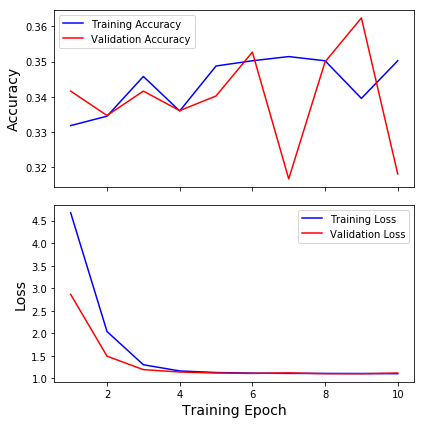

[io] Figure saved as models/model_0A/fig_keras_history  02-27-2020 11-48-27.ext


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 1s 365us/step
    - Accuracy:0.3384
    - Loss:1.1106

- Evaluating Test Data:
723/723 [==============================] - 0s 342us/step
    - Accuracy:0.3278
    - Loss:1.1184

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.3269,1,0.4927,236
1,0,0,0,241
2,1,0.0041,0.0081,246
accuracy,0.3278,0.3278,0.3278,0.3278
macro avg,0.4423,0.3347,0.1669,723
weighted avg,0.4469,0.3278,0.1636,723


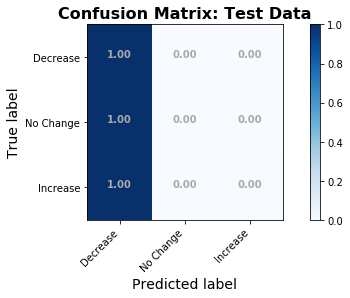

In [64]:
cm_fname = 'models/model_0A/fig_conf_mat.ext'
hist_fname = 'models/model_0A/fig_keras_history.ext'
summary_fname ='models/model_0A/model_summary'

df_class_report0A_wv, fig0A_wv=ji.evaluate_classification_model(model0_wv,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                                history=history0_wv,
#                                                    report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True, 
                                                   save_history=True, history_filename=hist_fname,
                                                   save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                                                   save_summary=True,summary_filename=summary_fname)

### Model 0 - GloVe

In [65]:
## MAKE GloVe EMBEDDING LAYER
# word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp,encoding='utf-8',embedding_dim=100)

def load_glove_embedding_layer(fp=None, trainable=False):
    if fp is None:
        fp = r'/Users/jamesirving/Datasets/glove.twitter.27B/glove.twitter.27B.100d.txt'

    ## Make GloVe embedding matrix
    word2index, embedding_matrix_gl = ji.load_glove_embeddings(fp=fp,encoding='utf-8',
                                                               embedding_dim=100,
                                                              X_train=X_train,
                                                              as_layer=False)
    print(f'gl:\n\tshape={embedding_matrix_gl.shape}')

    from keras import layers         
    vocab_size = embedding_matrix_gl.shape[0]#len(wv.vocab)
    vector_size = embedding_matrix_gl.shape[1]#wv.vector_size

    embedding_layer_gl =layers.Embedding(vocab_size,#+1,
                                      vector_size,
                                      input_length=X_train.shape[1],
                                      weights=[embedding_matrix_gl],
                                      trainable=trainable)#,X_train=X_train)
    return word2index, embedding_layer_gl

# glove_word2index, embedding_layer_gl = load_glove_embedding_layer(trainable=True)
glove_word2index, embedding_layer_gl = load_glove_embedding_layer(trainable=False)


gl:
	shape=(1193515, 100)


In [66]:
from keras import callbacks, models, layers, optimizers, regularizers
## Make model infrastructure:
model0_gl = models.Sequential()

## Get and add embedding_layer
model0_gl.add(embedding_layer_gl)
model0_gl.add(layers.SpatialDropout1D(0.2))

# model0_gl.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=True,
#                        dropout=0.5,recurrent_dropout=0.2,
#                        kernel_regularizer=regularizers.l2(.01))))
model0_gl.add(layers.Bidirectional(layers.LSTM(units=100, return_sequences=False)))#,
#                        dropout=0.5,recurrent_dropout=0.2)))#,
#                        kernel_regularizer=regularizers.l2(.01))))

model0_gl.add(layers.Dense(3, activation='softmax'))

model0_gl.compile(loss='categorical_crossentropy',optimizer="adadelta",metrics=['acc']) #optimizer=""rmsprop""
print(model0_gl.summary())

## set params
num_epochs = 15
# validation_split = 0.2
clock = bs.Clock()
clock.tic()
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

history0_gl = model0_gl.fit(X_train, y_train, 
                      epochs=num_epochs,
                      verbose=True, 
                      validation_data=(X_val,y_val),#validation_split=validation_split,
                      batch_size=100)
                      

clock.toc()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (None, 34, 100)           119351500 
_________________________________________________________________
spatial_dropout1d_1 (Spatial (None, 34, 100)           0         
_________________________________________________________________
bidirectional_2 (Bidirection (None, 200)               160800    
_________________________________________________________________
dense_2 (Dense)              (None, 3)                 603       
Total params: 119,512,903
Trainable params: 161,403
Non-trainable params: 119,351,500
_________________________________________________________________
None
--- CLOCK STARTED @:    02/27/20 - 11:49:19 AM --- 
------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
Train on 3372 samples, validate on 72

Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:49:19 AM,"0 min, 29.140 sec",--


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


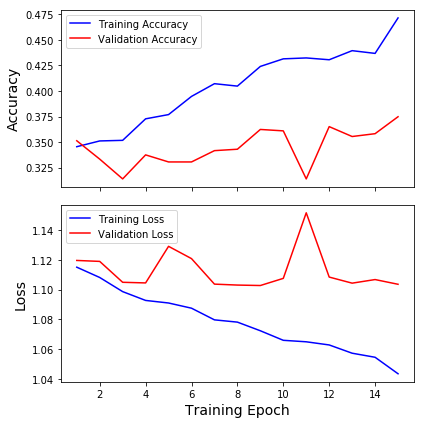



------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 1s 196us/step
    - Accuracy:0.5062
    - Loss:1.0167

- Evaluating Test Data:
723/723 [==============================] - 0s 198us/step
    - Accuracy:0.3638
    - Loss:1.1105

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.4051,0.2712,0.3249,236
1,0.355,0.3859,0.3698,241
2,0.3498,0.4309,0.3862,246
accuracy,0.3638,0.3638,0.3638,0.3638
macro avg,0.37,0.3627,0.3603,723
weighted avg,0.3696,0.3638,0.3607,723


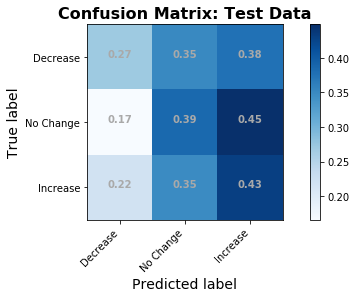

In [67]:
# cm_fname = file_dict['model_0A']['fig_conf_mat.ext']
# hist_fname = file_dict['model_0A']['fig_keras_history.ext']
# summary_fname = file_dict['model_0A']['model_summary']

df_class_report0A_gl,fig0A_gl=ji.evaluate_classification_model(model0_gl,
                                                   X_train, X_test,
                                                   y_train, y_test, 
                                                               history=history0_gl,
#                                                    report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True)#, 
#                                                    save_history=True, history_filename=hist_fname,
#                                                    save_conf_matrix_png=True, conf_mat_filename=cm_fname,
#                                                    save_summary=True,summary_filename=summary_fname)

In [68]:
y_pred_model0_gl = model0_gl.predict(X_test)

In [69]:
np.mean(np.array([0.47, 0.42, 0.18]))

0.35666666666666663

In [70]:
def my_custom_scorer(y_true,y_pred, model=None, **kwargs):
    """My custom score function to use with sklearn's GridSearchCV
    Maximizes the average accuracy per class using a normalized confusion matrix"""
    from sklearn.metrics import make_scorer,confusion_matrix
    
    # set labels if provided
    if 'labels' in kwargs:
        labels = kwargs['labels']
    else:
        labels=np.unique(y_true)
    
    if y_true.ndim>1 or y_pred.ndim>1:
    
        ## reduce dimensions of y_train and y_test
        if y_true.ndim>1:            
            y_true = y_true.argmax(axis=1)
        if y_pred.ndim>1:
            y_pred = y_pred.argmax(axis=1)
            
    # Get confusion matrx
    cm = confusion_matrix(y_true, y_pred)
    
    # Normalize confusion matrix
    cm_norm = cm.astype('float')/cm.sum(axis=1)[:,np.newaxis]
    
    ## Get diagonals for class accuracy
    diag = cm_norm.diagonal()
    score = np.mean(diag)
    print(f'Mean Class Accuracy = {score}')
    print(f'Class Accuracy Values:')
    print(diag)    
    
    
    ji.plot_confusion_matrix(cm,normalize=True)
    
    return score

Mean Class Accuracy = 0.3626576219345427
Class Accuracy Values:
[0.27118644 0.38589212 0.43089431]


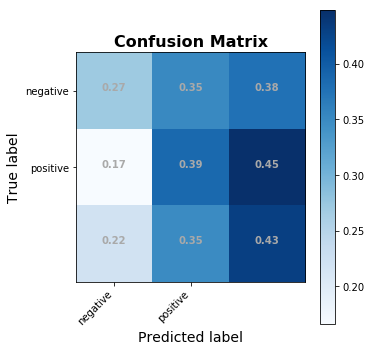

0.3626576219345427

In [71]:
my_custom_scorer(y_test, y_pred_model0_gl)
# np.mean[[0.47058824, 0.42307692 0.18253968]]

In [72]:
def save_best_nlp_model(model):
    model_key='nlp_model_for_predictions'
    filename = file_dict[model_key]['base_filename']
    nlp_files = ji.save_model_weights_params(model0,check_if_exists=True,auto_increment_name=True, 
                                         auto_filename_suffix=True,filename_prefix=filename)
    return nlp_files


In [73]:
# save_me_as_model_0A=True
# save_me_as_pred_nlp = False

# ji.reload(ji)
# if save_me_as_pred_nlp:
#     model_key='nlp_model_for_predictions'

# elif save_me_as_model_0A:
#     model_key='model_0A'    
    
# # filename = file_dict[model_key]['base_filename']
# nlp_files = ji.save_model_weights_params(model0_gl,check_if_exists=True,auto_increment_name=True, 
#                                          auto_filename_suffix=True,filename_prefix=filename)

# file_dict[model_key]['output_filenames'] = nlp_files

# ji.update_file_directory(file_dict)

### Kera's Example Pretrained Word Embeddings Network

#### CNN Parameters 
https://machinelearningmastery.com/best-practices-document-classification-deep-learning/

- See notebook `keras_hyperparameter_tuning.ipynb`for gridsearch

```python
# Create HyperParaemeter Space
params_to_search ={'filter_size':[3,4,5,6],
                   'activation':['relu','tanh','linear'],
                   'n_filters':[100,200],#,300,400],
                  'dropout':[0.2],
                  'optimizer':['adam','rmsprop','adadelta'],
                'epochs':[10]}


create_model(embedding_layer=embedding_layer_gl,trainable=False,
              n_filters=100, filter_size=4,
              activation='tanh', optimizer='adadelta',
              dropout=0.2,l2_lr=0.01,
              batch_size=100,
              epochs=10,verbose = 0,show_summary=False)
best results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'optimizer': 'adadelta'}
```

##### Things to Try:
1. Weight Regularization (L2):3 
2. Adadelta Optimizer

In [74]:
## Get a trainable embedding_layer with GloVe Emebddings
_,embedding_layer_gl=load_glove_embedding_layer(trainable=False)


## Save the initial weights before any training
gl_initial_weights = embedding_layer_gl.get_weights()

gl:
	shape=(1193515, 100)


In [75]:
params_to_search ={'filter_size':[3,4,5,6],
                   'activation':['relu','tanh','linear'],
                   'n_filters':[100,200],#,300,400],
                  'dropout':[0.2],
                  'optimizer':['adam','rmsprop','adadelta'],
                'epochs':[10]}

def model_cnn(embedding_layer, X_train, X_test,
              y_train,y_test,
              X_val, y_val,
              n_filters=128, filter_size=4,
              activation='relu', optimizer='rmsprop',
              dropout=0.2,l2_lr=0.01,
              batch_size=128,
              epochs=10,verbose = 1,trainable_embedding=False,show_summary=False):
    
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2
    embedding_layer.trainable=trainable_embedding
    print(f'Embedding layer trainable={embedding_layer.trainable}')

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer_gl(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation='relu')(x) #128
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
    if show_summary:
        display(model.summary())
    
    
    
    clock = bs.Clock()
    clock.tic(f'units={n_filters}, filter={filter_size},dropout={dropout},opt={optimizer}')
    history = model.fit(X_train, y_train,
                        batch_size=batch_size,
                        epochs=epochs,verbose=verbose,
                        validation_data=(X_val,y_val))

              #validation_split=0.1)
    clock.toc('')
    df_class_report0_CNN,fig0_CNN=ji.evaluate_classification_model(model,
                                                       X_train, X_test,
                                                       y_train, y_test, 
#                                                        report_as_df=False,
                                                                   history=history,
                                                       binary_classes=False,
                                                       conf_matrix_classes=['Decrease','No Change','Increase'],
                                                       normalize_conf_matrix=True)
    
    return model, df_class_report0_CNN

Embedding layer trainable=False
Training model.

--- CLOCK STARTED @:    02/27/20 - 11:50:40 AM           Label: units=100, filter=4,dropout=0.2,opt=adadelta --- 
Train on 3372 samples, validate on 723 samples
Epoch 1/10
3372/3372 [==============================] - 2s 690us/step - loss: 1.6708 - acc: 0.3357 - val_loss: 1.5755 - val_acc: 0.3416
Epoch 2/10
3372/3372 [==============================] - 2s 538us/step - loss: 1.5168 - acc: 0.3227 - val_loss: 1.4452 - val_acc: 0.3361
Epoch 3/10
3372/3372 [==============================] - 2s 552us/step - loss: 1.3999 - acc: 0.3434 - val_loss: 1.3633 - val_acc: 0.3167
Epoch 4/10
3372/3372 [==============================] - 2s 523us/step - loss: 1.3183 - acc: 0.3571 - val_loss: 1.2868 - val_acc: 0.3416
Epoch 5/10
3372/3372 [==============================] - 2s 526us/step - loss: 1.2590 - acc: 0.3452 - val_loss: 1.2358 - val_acc: 0.3154
Epoch 6/10
3372/3372 [==============================] - 2s 530us/step - loss: 1.2137 - acc: 0.3517 - val_loss:

Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:50:40 AM,"0 min, 19.369 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


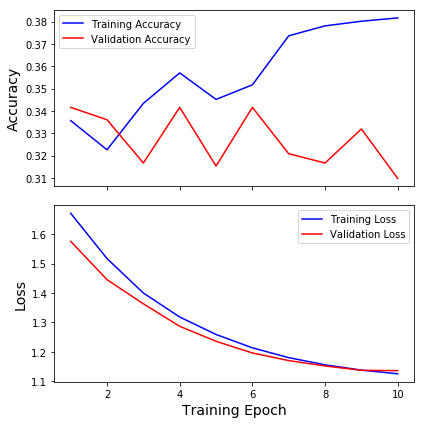



------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 0s 93us/step
    - Accuracy:0.3440
    - Loss:1.1220

- Evaluating Test Data:
723/723 [==============================] - 0s 81us/step
    - Accuracy:0.3292
    - Loss:1.1349

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.3261,0.9576,0.4865,236
1,0.4,0.0498,0.0886,241
2,0,0,0,246
accuracy,0.3292,0.3292,0.3292,0.3292
macro avg,0.242,0.3358,0.1917,723
weighted avg,0.2398,0.3292,0.1883,723


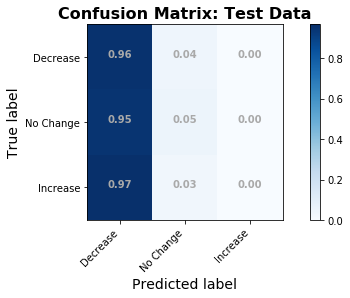

In [76]:
## Use results from grid search
best_results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'optimizer': 'adadelta'}
outputs= model_cnn(embedding_layer_gl,
                   X_train, X_test,
                   y_train, y_test, 
                   X_val,y_val,l2_lr=0.005,
                   trainable_embedding=False,
                   
                   **best_results)

In [77]:



def create_model(embedding_layer=embedding_layer_gl,trainable=False,
              n_filters=128, filter_size=4,
              activation='relu', optimizer='rmsprop',
              dropout=0.2,l2_lr=0.01,
              batch_size=100,
              epochs=10,verbose = 0,show_summary=False):
    
    embedding_layer.trainable=trainable
    print(f'Embedding layer trainable={embedding_layer.trainable}')
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    ##
    x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
              kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
    x = Dropout(dropout)(x)
    x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation=activation )(x) #128'relu'
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
    if show_summary:
        display(model.summary())
    return model



In [78]:
def fit_model(model,X_train,y_train,batch_size,epochs,verbose,validation_data):
    
    clock = bs.Clock()
#     clock.tic(f'units={n_filters}, filter={filter_size},dropout={dropout},opt={optimizer}')
    history = model.fit(X_train, y_train,
                        batch_size=batch_size,
                        epochs=epochs,verbose=verbose,
                        validation_data=(X_val,y_val))

              #validation_split=0.1)
    clock.toc('')
    df_class_report0_CNN,fig0_CNN=ji.evaluate_classification(model,history,
                                                       X_train, X_test,
                                                       y_train, y_test, 
                                                       report_as_df=False,
                                                       binary_classes=False,
                                                       conf_matrix_classes=['Decrease','No Change','Increase'],
                                                       normalize_conf_matrix=True)
    
    return model, df_class_report0_CNN

In [79]:
y_pred_model0_gl = model0_gl.predict(X_test)
# score, cm_norm = my_custom_scorer(y_test,y_pred_model0_gl)
# print(cm_norm, cm_norm.shape)

In [80]:
RUN_GRID_SEARCH=False

from sklearn.model_selection import GridSearchCV
tune_clock = bs.Clock()
from keras import models, layers
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV

neural_network = KerasClassifier(build_fn=create_model,verbose=2)    

best_results={'activation': ['tanh'], 
              'dropout': [0.2],
              'epochs': [10,15],#,20]
              'filter_size': [4,7],
              'batch_size':[50,100,300],
              'n_filters': [100,300],
              'optimizer': ['adadelta'],
             'l2_lr':[0.005,0.003,0.03]}
grid = GridSearchCV(estimator=neural_network,param_grid=best_results,scoring=make_scorer(my_custom_scorer))



if RUN_GRID_SEARCH:
    tune_clock.tic()
    grid_result = grid.fit(X_train, y_train)
    tune_clock.toc()
    grid.best_params_
else:
    print('[!] Grid search skipped (RUN_GRID_SEARCH=FALSE)')

[!] Grid search skipped (RUN_GRID_SEARCH=FALSE)


- REsults from overnight gridsearch
-params ran:
```python
params={'activation': ['tanh'], 
              'dropout': [0.2],
              'epochs': [10,15],#,20]
              'filter_size': [4,7],
              'batch_size':[50,100,300],
              'n_filters': [100,300],
              'optimizer': ['adadelta'],
             'l2_lr':[0.005,0.003,0.03]}
```
- best _params

```python

{'activation': 'tanh',
 'batch_size': 100,
 'dropout': 0.2,
 'epochs': 10,
 'filter_size': 4,
 'l2_lr': 0.005,
 'n_filters': 100,
 'optimizer': 'adadelta'}
```

Embedding layer trainable=False
Training model.
--- CLOCK STARTED @:    02/27/20 - 11:51:01 AM           Label: units=100, filter=4,dropout=0.2,opt=adadelta --- 
Train on 3372 samples, validate on 723 samples
Epoch 1/10
3372/3372 [==============================] - 2s 678us/step - loss: 1.6625 - acc: 0.3428 - val_loss: 1.5641 - val_acc: 0.3181
Epoch 2/10
3372/3372 [==============================] - 2s 548us/step - loss: 1.4949 - acc: 0.3399 - val_loss: 1.4261 - val_acc: 0.3430
Epoch 3/10
3372/3372 [==============================] - 2s 546us/step - loss: 1.3793 - acc: 0.3357 - val_loss: 1.3306 - val_acc: 0.3527
Epoch 4/10
3372/3372 [==============================] - 2s 538us/step - loss: 1.2972 - acc: 0.3425 - val_loss: 1.2625 - val_acc: 0.3223
Epoch 5/10
3372/3372 [==============================] - 2s 544us/step - loss: 1.2380 - acc: 0.3452 - val_loss: 1.2137 - val_acc: 0.3264
Epoch 6/10
3372/3372 [==============================] - 2s 544us/step - loss: 1.1950 - acc: 0.3464 - val_loss: 

Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:51:01 AM,"0 min, 20.058 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


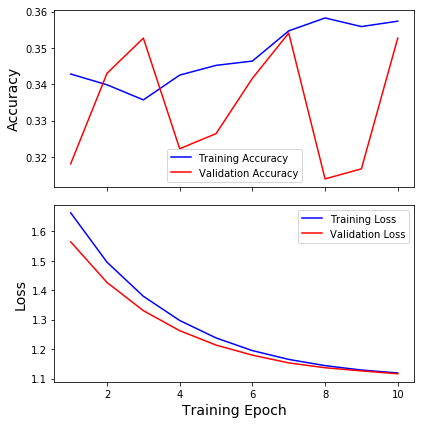



------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 0s 84us/step
    - Accuracy:0.3941
    - Loss:1.1134

- Evaluating Test Data:
723/723 [==============================] - 0s 79us/step
    - Accuracy:0.3347
    - Loss:1.1167

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.3143,0.0932,0.1438,236
1,0.3333,0.1867,0.2394,241
2,0.3378,0.7114,0.4581,246
accuracy,0.3347,0.3347,0.3347,0.3347
macro avg,0.3285,0.3304,0.2804,723
weighted avg,0.3286,0.3347,0.2826,723


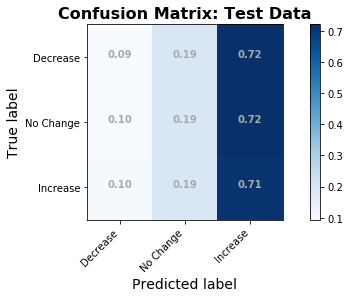

In [81]:
## Use results from grid search
best_results={'activation': 'tanh', 
              'dropout': 0.2,
              'epochs': 10,
              'filter_size': 4,
              'n_filters': 100,
              'l2_lr':0.005,
              'optimizer': 'adadelta'}
outputs= model_cnn(embedding_layer_gl,
                   X_train, X_test,
                   y_train, y_test, 
                   X_val,y_val,
                   trainable_embedding=False,
                   **best_results)

In [82]:
# help(GridSearchCV)

In [83]:
print(pd.datetime.now())

2020-02-27 11:51:23.312407


# BOOKMARK 09/28/19

In [84]:

def create_deep_model(embedding_layer=embedding_layer_gl,trainable=False,
                       n_conv_layers=3,n_filters=128, filter_size=4,
                      activation='tanh', optimizer='adadelta',
                      dropout=0.2,l2_lr=0.005,
                      batch_size=100,
                      epochs=10,verbose = 1):
    
    ## Print out parameters used to create model
    vars = locals()
    dashes = '---'*20
    print('\n\n')
    print(dashes)
    now = pd.datetime.now()
    print(now.strftime('%m/%d/%Y-%T'))
    print(vars)    
    
    embedding_layer.trainable=trainable
    print(f'Embedding layer trainable={embedding_layer.trainable}')
    from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout
    from keras.models import Model
    from keras.regularizers import l2

    print('Training model.')
    MAX_SEQUENCE_LENGTH = X_train.shape[1]

    # train a 1D convnet with global maxpooling
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    embedded_sequences = embedding_layer(sequence_input)
    ## Specify layer parameters


    ##
    x = Conv1D(n_filters, filter_size, activation=activation, #data_format='channels_first',
               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(embedded_sequences)
    
    x = Dropout(dropout)(x)
    x = MaxPooling1D(filter_size)(x)
    
    
    
    ## Loop to create n_conv_layers
    
    for n in range(n_conv_layers):
        x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
                   kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
        x = Dropout(dropout)(x)
        
        if n==n_conv_layers-1:
            x = GlobalMaxPooling1D()(x)
        else:
            x = MaxPooling1D(filter_size)(x)
    
# #     ##
#     x = Conv1D(n_filters, filter_size, activation=activation,data_format='channels_first',
#               kernel_regularizer=l2(l2_lr), bias_regularizer=l2(l2_lr))(x) 
#     x = Dropout(dropout)(x)
#     x = GlobalMaxPooling1D()(x)
    
    ##
    x = Dense(n_filters, activation=activation )(x) #128'relu'
    preds = Dense(3, activation='softmax')(x)

    model = Model(sequence_input, preds)
    model.compile(loss='categorical_crossentropy',
                  optimizer=optimizer, #'rmsprop',#adam
                  metrics=['acc'])
    
#     if show_summary:
#     print()
    display(model.summary())
    return model



In [85]:
from sklearn.model_selection import GridSearchCV
tune_clock = bs.Clock()
from keras import models, layers
from keras.wrappers.scikit_learn import KerasClassifier, KerasRegressor
from sklearn.model_selection import GridSearchCV

neural_network_deep = KerasClassifier(build_fn=create_deep_model,verbose=1)

params_deep_model={'n_conv_layers':[3],#,5],
                  'n_filters': [5,100],#,200],
                 'l2_lr':[0.01],#0.005,
                  'epochs':[10]}
# params_deep_model={'activation': ['tanh'], 
#                    'n_conv_layers':[3,5],
#                   'dropout': [0.2],
#                   'epochs': [10],#,20]
#                   'filter_size': [4],
#                   'batch_size':[100],
#                   'n_filters': [100,200],
#                   'optimizer': ['adadelta'],
#                  'l2_lr':[0.005,0.01]}
grid = GridSearchCV(estimator=neural_network_deep,param_grid=params_deep_model)#,
#                    n_jobs=3)
print(params_deep_model)

if RUN_GRID_SEARCH:
    tune_clock.tic()
    grid_result = grid.fit(X_train, y_train)
    tune_clock.toc()
    results = grid_result.cv_results_
    print(type(results))
    best_deep_params = grid.best_params_
    print(best_deep_params)


{'n_conv_layers': [3], 'n_filters': [5, 100], 'l2_lr': [0.01], 'epochs': [10]}


In [86]:
# ihelp(grid_result)

In [87]:

fit_model_kws={'X_train':X_train, 'y_train':y_train,
                         'batch_size':100, 'epochs':10, 'verbose':True,
                         'validation_data':(X_val,y_val)}

In [88]:
# model, results = fit_model(create_deep_model(embedding_layer_gl,**best_deep_params),
#                           **fit_model_kws)

In [89]:

# ji.evaluate_classification_model(grid_result, X_train, X_test, y_train, y_test, 
#                            binary_classes=False,
#                            conf_matrix_classes=['Decrease','No Change','Increase'],
#                            normalize_conf_matrix=True)
# #                                     /               save_history=True, history_filename=hist_fname,
# #                                                    save_conf_matrix_png=True, conf_mat_filename=cm_fname,
# #                                                    save_summary=True,summary_filename=summary_fname))

In [90]:
# cm_fname = file_dict['model_0A']['fig_conf_mat.ext']
# hist_fname = file_dict['model_0A']['fig_keras_history.ext']
# summary_fname = file_dict['model_0A']['model_summary']

# df_class_report0A,fig0A=ji.evaluate_classification(model,history,
#                                                    X_train, X_test,
#                                                    y_train, y_test, 
#                                                    report_as_df=False,
#                                                    binary_classes=False,
#                                                    conf_matrix_classes=['Decrease','No Change','Increase'],
#                                                    normalize_conf_matrix=True, 
#                                                    save_history=True, history_filename=hist_fname,
#                                                    save_conf_matrix_png=True, conf_mat_filename=cm_fname,
#                                                    save_summary=True,summary_filename=summary_fname)

#### Additional Dense Layers after CNN

In [91]:
##CNN+ MORE DENSE LAYERS
from keras.layers import Input, Conv1D,GlobalMaxPooling1D, MaxPooling1D, Dense, Dropout,Flatten
from keras.models import Model

print('Training model.')
MAX_SEQUENCE_LENGTH = X_train.shape[1]

# train a 1D convnet with global maxpooling
sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
embedded_sequences = embedding_layer_gl(sequence_input)
## Specify layer parameters
n_units =128
filter_size=4
dropout =0.2
x = Conv1D(n_units, filter_size, activation='relu')(embedded_sequences)
x = Dropout(dropout)(x)
x = MaxPooling1D(filter_size)(x)
x = Conv1D(n_units, filter_size, activation='relu',data_format='channels_first')(x)
x = Dropout(dropout)(x)
x = MaxPooling1D(filter_size)(x)
x = Conv1D(n_units, filter_size, activation='relu')(x)

x = Dropout(dropout)(x)
x = GlobalMaxPooling1D()(x)

# x = Flatten()
x = Dense(1024,activation='relu')(x)
x = Dropout(dropout)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(dropout)(x)

x = Dense(n_units, activation='relu')(x) #128
preds = Dense(3, activation='softmax')(x)

model = Model(sequence_input, preds)
model.compile(loss='categorical_crossentropy',
              optimizer='rmsprop',#'rmsprop',#'adam',#
              metrics=['acc'])
model.summary()

Training model.
Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 34)                0         
_________________________________________________________________
embedding_3 (Embedding)      (None, 34, 100)           119351500 
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 31, 128)           51328     
_________________________________________________________________
dropout_7 (Dropout)          (None, 31, 128)           0         
_________________________________________________________________
max_pooling1d_5 (MaxPooling1 (None, 7, 128)            0         
_________________________________________________________________
conv1d_8 (Conv1D)            (None, 128, 125)          3712      
_________________________________________________________________
dropout_8 (Dropout)          (None, 128, 12

In [92]:
clock = bs.Clock()
clock.tic('')
history = model.fit(X_train, y_train,
                    batch_size=256,#128,
                    epochs=20,
                    validation_data=(X_val,y_val))
                    
          #validation_split=0.1)
clock.toc('')

--- CLOCK STARTED @:    02/27/20 - 11:51:23 AM           Label:            --- 
Train on 3372 samples, validate on 723 samples
Epoch 1/20
3372/3372 [==============================] - 2s 659us/step - loss: 1.2042 - acc: 0.3250 - val_loss: 1.1003 - val_acc: 0.3167
Epoch 2/20
3372/3372 [==============================] - 2s 495us/step - loss: 1.0994 - acc: 0.3295 - val_loss: 1.1004 - val_acc: 0.3402
Epoch 3/20
3372/3372 [==============================] - 2s 497us/step - loss: 1.0993 - acc: 0.3547 - val_loss: 1.0984 - val_acc: 0.3278
Epoch 4/20
3372/3372 [==============================] - 2s 491us/step - loss: 1.0994 - acc: 0.3342 - val_loss: 1.0983 - val_acc: 0.3416
Epoch 5/20
3372/3372 [==============================] - 2s 492us/step - loss: 1.0992 - acc: 0.3324 - val_loss: 1.0976 - val_acc: 0.3527
Epoch 6/20
3372/3372 [==============================] - 2s 492us/step - loss: 1.0988 - acc: 0.3529 - val_loss: 1.1032 - val_acc: 0.3167
Epoch 7/20
3372/3372 [==============================] - 2

Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:51:23 AM,"0 min, 35.326 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


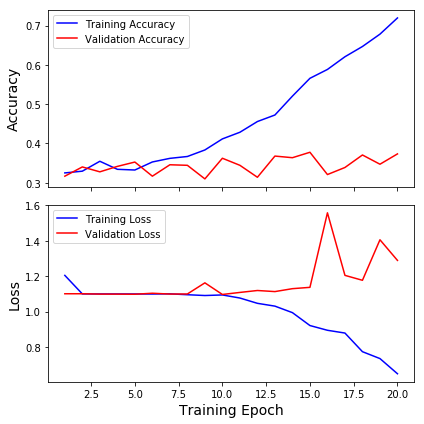



------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 1s 216us/step
    - Accuracy:0.8004
    - Loss:0.5333

- Evaluating Test Data:
723/723 [==============================] - 0s 213us/step
    - Accuracy:0.3541
    - Loss:1.2722

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.3308,0.1864,0.2385,236
1,0.3523,0.668,0.4613,241
2,0.3835,0.2073,0.2691,246
accuracy,0.3541,0.3541,0.3541,0.3541
macro avg,0.3555,0.3539,0.323,723
weighted avg,0.3559,0.3541,0.3232,723


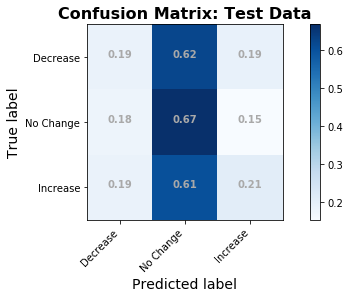

In [93]:
reload(ji)
df_class_report0_CNN,fig0_CNN=ji.evaluate_classification(model,history,
                                                   X_train, X_test,
                                                   y_train, y_test, 
#                                                          history=history,
                                                   report_as_df=False,
                                                   binary_classes=False,
                                                   conf_matrix_classes=['Decrease','No Change','Increase'],
                                                   normalize_conf_matrix=True)

#### Combining Multiple Filters into a Functional CNN Model
- https://medium.com/datadriveninvestor/deep-learning-techniques-for-text-classification-9392ca9492c7 

### Model 0A Summary
Our model had difficulty classifying tweets by `delta_price`, but did perform better than chance (36% accuracy vs chance=33%). We will next attempt to use another type of recurrent-neural-network layer, the Gated Rectifier Unit (GRU).

## Model 0B

In [94]:
# ## ADDING PRETRAINED GLOVE EMBEDDINGS
# word2index, embedding_matrix = ji.load_glove_embeddings(fp,encoding='utf-8',embedding_dim=100)

# vocab_size = embedding_matrix.shape[0]
# vector_size = embedding_matrix.shape[1]

# from keras import layers         
# embedding_layer =layers.Embedding(vocab_size,#+1,
#                                   vector_size,
#                                   input_length=X_train.shape[1],
#                                   weights=[embedding_matrix],
#                                   trainable=False)

In [95]:
# model0B.get_

In [96]:
## GRU Model
from keras import models, layers, optimizers, regularizers
model0B = models.Sequential()

## Get and add embedding_layer
# embedding_layer = ji.make_keras_embedding_layer(wv, X_train)
model0B.add(embedding_layer_gl)

model0B.add(layers.SpatialDropout1D(0.5))
model0B.add(layers.Bidirectional(layers.GRU(units=100, dropout=0.5, recurrent_dropout=0.2,return_sequences=True)))
model0B.add(layers.Bidirectional(layers.GRU(units=100, dropout=0.5, recurrent_dropout=0.2)))
model0B.add(layers.Dense(3, activation='softmax'))

model0B.compile(loss='categorical_crossentropy',optimizer="adam",metrics=['acc'])#,'val_acc'])#, callbacks=callbacks)
model0B.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (None, 34, 100)           119351500 
_________________________________________________________________
spatial_dropout1d_2 (Spatial (None, 34, 100)           0         
_________________________________________________________________
bidirectional_3 (Bidirection (None, 34, 200)           120600    
_________________________________________________________________
bidirectional_4 (Bidirection (None, 200)               180600    
_________________________________________________________________
dense_11 (Dense)             (None, 3)                 603       
Total params: 119,653,303
Trainable params: 301,803
Non-trainable params: 119,351,500
_________________________________________________________________


In [97]:
num_epochs = 5

clock = bs.Clock()
clock.tic()
historyB = model0B.fit(X_train, y_train, epochs=num_epochs, verbose=True, validation_split=0.1,
                     batch_size=300)#, class_weight=class_weight)#callbacks=callbacks,, validation_data=(X_val))
clock.toc()

--- CLOCK STARTED @:    02/27/20 - 11:52:02 AM --- 
Train on 3034 samples, validate on 338 samples
Epoch 1/5
3034/3034 [==============================] - 4s 1ms/step - loss: 20.0603 - acc: 0.3418 - val_loss: 1.1407 - val_acc: 0.3491
Epoch 2/5
3034/3034 [==============================] - 3s 903us/step - loss: 11.8059 - acc: 0.3504 - val_loss: 1.1214 - val_acc: 0.3462
Epoch 3/5
3034/3034 [==============================] - 3s 893us/step - loss: 8.5864 - acc: 0.3339 - val_loss: 1.1126 - val_acc: 0.3432
Epoch 4/5
3034/3034 [==============================] - 3s 897us/step - loss: 6.4589 - acc: 0.3256 - val_loss: 1.1134 - val_acc: 0.3462
Epoch 5/5
3034/3034 [==============================] - 3s 914us/step - loss: 4.8844 - acc: 0.3395 - val_loss: 1.1118 - val_acc: 0.3432
--- TOTAL DURATION   =  0 min, 17.883 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:52:02 AM,"0 min, 17.883 sec",--


In [98]:
file_dict=io.def_filename_dictionary()
model_key = "model_0B" 
cm_fname = file_dict[model_key]['fig_conf_mat.ext']
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

[i] filename_directory loaded from data/filename_dictionary.json.
------------ Dictionary Contents ------------


interactive(children=(Dropdown(description='dict_to_display', options={'file_directory': {'history': '', 'file…

[i] creating all required folders...


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


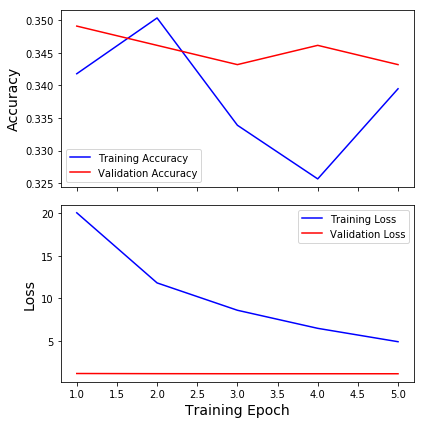

[io] Figure saved as results/model0B/model0B_keras_history  02-27-2020 11-52-20.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------

- Evaluating Training Data:
3372/3372 [==============================] - 2s 471us/step
    - Accuracy:0.3378
    - Loss:1.1181

- Evaluating Test Data:
723/723 [==============================] - 0s 486us/step
    - Accuracy:0.3320
    - Loss:1.1201

------------------------------------------------------------------------------------------
	CLASSIFICATION REPORT:
------------------------------------------------------------------------------------------


,precision,recall,f1-score,support
0,0.3277,0.9873,0.4921,236
1,0,0,0,241
2,0.5833,0.0285,0.0543,246
accuracy,0.332,0.332,0.332,0.332
macro avg,0.3037,0.3386,0.1821,723
weighted avg,0.3054,0.332,0.1791,723


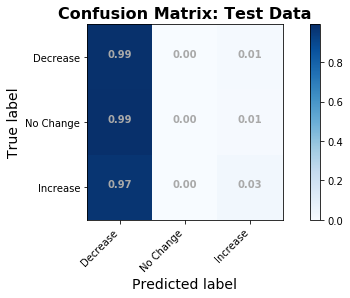

In [99]:
reload(ji)
df_class_report0B, fig0B  = ji.evaluate_classification(model0B, historyB, 
                           X_train, X_test, y_train,y_test,report_as_df=False,
                           conf_matrix_classes=['Decrease','No Change','Increase'],
                           binary_classes=False, normalize_conf_matrix=True, 
                           save_history=True, history_filename=hist_fname, 
                           save_conf_matrix_png=True, conf_mat_filename=cm_fname,
                           save_summary=True,summary_filename=summary_fname)

In [100]:
# save_me_as_model_0B=True
# save_me_as_pred_nlp = True

# ji.reload(ji)
# if save_me_as_pred_nlp:
#     model_key='nlp_model_for_predictions'

# elif save_me_as_model_0B:
#     model_key='model_0B'    
    
# filename = file_dict[model_key]['base_filename']
# nlp_files = ji.save_model_weights_params(model0B,check_if_exists=True,auto_increment_name=True, 
#                                          auto_filename_suffix=True,filename_prefix=filename)

# file_dict[model_key]['output_filenames'] = nlp_files

# ji.update_file_directory(file_dict)
# # ji.dict_dropdown(file_dict)

### Model 0B Summary

The GRU performed better than the LSTM model, with 39% validation accuracy.

In [101]:
ji.inspect_variables(locals(),show_how_to_delete=False)
del_me= ['one_hot_results','nlp_df','text_data']#list of variable names
for me in del_me:    
    try: 
        exec(f'del {me}')
        print(f'del {me} succeeded')
    except:
        print(f'del {me} failed')
        continue

,type,size
variable,,
embedding_matrix_gl,ndarray,954812112
stock_df,DataFrame,45310488
glove_word2index,dict,41943144
word2index,dict,41943144
twitter_df,DataFrame,28481592
date_time_index,Series,26903164
nlp_df,DataFrame,23353977
embedding_matrix_wv,ndarray,14349712
df_tokenize,DataFrame,11522625


#[i] set `print_names=True` for var names to copy/paste.
---------------------------------------------
del one_hot_results failed
del nlp_df succeeded
del text_data succeeded


# FORECASTING STOCK MARKET PRICE

## Loading & Processing Stock Data (SCRUB)

In [9]:
# DISPLAY CODE TO BE USED BELOW TO LOAD AND PROCESS STOCK DATA
functions_used=[ji.load_processed_stock_data, # This script combines the oriignal 4 used:
                ji.load_raw_stock_data_from_txt,
                ji.set_timeindex_freq,ji.custom_BH_freq,
               ji.get_technical_indicators]

ji.ihelp_menu(functions_used)
ji.save_ihelp_menu_to_file(functions_used,'_stock_df_processing')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('load_pr…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_df_processing.md


## Model 1: Using Price as only feature

### Choosing Appropriate Metrics for Time Series Forecasting

- Due to the estimation of price being a precise regression, accuracy will not be an appropriate metric for judging model performance. 
 - e.g. if the price was \\$ 114.23 and our model predicted \\$ 114.25, our accuracy is 0.<br><br>

- **Thiel's U:**
    - [Source of Equation/Explanation of Metric](https://docs.oracle.com/cd/E57185_01/CBREG/ch06s02s03s04.html)
    - $ U = \sqrt{\frac{\sum_{t=1 }^{n-1}\left(\frac{\bar{Y}_{t+1} - Y_{t+1}}{Y_t}\right)^2}{\sum_{t=1 }^{n-1}\left(\frac{Y_{t+1} - Y_{t}}{Y_t}\right)^2}}$


|Thiel's U Value | Interpretation |
| --- | --- |
| <1 | Forecasting is better than guessing| 
| 1 | Forecasting is about as good as guessing| 
|>1 | Forecasting is worse than guessing|

In [10]:
import os
os.listdir('data/')

['filename_dictionary.json',
 'SP500_1min_01_23_2020.xlsx',
 'trump_tweets_12012016_to_01012020.csv',
 '_combined_stock_data_raw_tweets.csv',
 '_combined_stock_data_plus_nlp.csv',
 'SP500_1min_01_23_2020_full.xlsx']

In [11]:
# fname = file_dict['stock_df']['raw_csv_file']

# ji.load_stock_df_from_csv()
reload(ji)
folderpath='data/'
filename = 'SP500_1min_01_23_2020.xlsx'
raw_stock_df = ji.load_raw_stock_data_from_txt(folderpath=folderpath,filename = filename, verbose=2)
# raw_stock_df =pd.read_excel('data/SP500_1min_01_23_2020.xlsx',parse_dates=False)
'.xlsx' in filename

[i] Loading data/SP500_1min_01_23_2020.xlsx...

[i] Exlcuding data earlier than 2016-12-01.
[i] Cleaning 0 values:
	 -replaced 14 zeroes in "BidClose" with np.nan ...".
	- dropping null values (`fill_or_drop_null`).
[i] Converting the datetimeindex to `freq` "CBH"
	- addressing resulting null values using fill_method ffill...
------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-01 09:30:00 -- to -- 2020-01-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,Date,Time,BidOpen,BidHigh,BidLow,BidClose,AskOpen,AskHigh,AskLow,AskClose,date_time_index,filled_timebin
date_time_index,,,,,,,,,,,,
2016-12-01 09:30:00,2016-12-01 00:00:00,09:30:00,92.15,92.36,92.15,92.32,92.41,92.42,92.34,92.4,2016-12-01 09:30:00,False
2016-12-01 10:30:00,2016-12-01 00:00:00,10:30:00,92.53,92.53,92.46,92.47,92.53,92.53,92.47,92.48,2016-12-01 10:30:00,False
2016-12-01 11:30:00,2016-12-01 00:00:00,11:30:00,92.53,92.53,92.52,92.53,92.53,92.54,92.53,92.54,2016-12-01 11:30:00,False
2016-12-01 12:30:00,2016-12-01 00:00:00,12:30:00,92.57,92.57,92.57,92.57,92.58,92.58,92.58,92.58,2016-12-01 12:30:00,False
2016-12-01 13:30:00,2016-12-01 00:00:00,13:30:00,92.33,92.33,92.33,92.33,92.34,92.34,92.34,92.34,2016-12-01 13:30:00,False


True

In [12]:
# raw_stock_df

In [13]:
# date_time_index = raw_stock_df["Date"].astype('str') + ' '+stock_df['Time'].astype('str')
# raw_stock_df['date_time_index'] = pd.to_datetime(date_time_index)

In [14]:
fig = ji.plotly_time_series(raw_stock_df, y_col='BidClose',as_figure=True)
stock_df = ji.get_technical_indicators(raw_stock_df,make_price_from='BidClose')
del raw_stock_df

# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2020-01-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-12-29 15:30:00,94.63,95.206735,94.627007,94.920214,95.074533,0.154319,0.987375,96.601756,92.652257,94.623977,87.63
2016-12-30 09:30:00,94.72,95.191837,94.643333,94.917490,95.065938,0.148448,0.966569,96.576471,92.710196,94.687992,87.72
2016-12-30 10:30:00,94.55,95.173061,94.657483,94.912504,95.053438,0.140934,0.946264,96.550010,92.764955,94.595997,87.55


In [15]:
stock_df.to_csv('data/_stock_df_with_technical_indicators.csv')

In [108]:
func_list = [ji.train_test_split_by_last_days,
           ji.make_scaler_library,
           ji.transform_cols_from_library,
           ji.make_train_test_series_gens]
ihelp_menu(func_list)
ji.save_ihelp_menu_to_file(func_list,'_stock_data_prep_for_modeling')

GridBox(box_style='warning', children=(HBox(children=(Label(value='Function Menu'), Dropdown(options=('train_t…

Output()

Functions saved as readme_resources/ihelp_outputs/_stock_data_prep_for_modeling.md


In [109]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=10
num_train_days= 260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2019-01-11 09:30:00 	 2020-01-09 15:30:00 = 1820 rows
test dates:	2020-01-09 15:30:00 	 2020-01-23 14:30:00 = 70 rows


In [110]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-01-11 09:30:00,101.78,100.283,98.9613,100.702,99.9754,-0.726524,2.6338,104.229,93.6937,101.905,94.78
2019-01-11 10:30:00,101.68,100.352,98.9452,100.713,100.016,-0.697106,2.62001,104.185,93.7051,101.755,94.68


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2019-01-11 09:30:00,0.00722892,0,0.00333832,0,0,0.216273,0.760501,0.00619591,0.0191091,0.0107474,0.00722892
2019-01-11 10:30:00,0.00378657,0.00232671,0.00281297,0.000380772,0.00135123,0.225397,0.755455,0.00462806,0.0194328,0.00553534,0.00378657


In [111]:
from keras.models import Sequential
from keras import optimizers
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window
n_features = 1 # just stock Price

print(f'input shape: ({n_input},{n_features})')
input_shape=(n_input, n_features)

# Create model architecture
model1 = Sequential()
model1.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
model1.add(LSTM(units=50, activation='relu'))
model1.add(Dense(1))

model1.compile(loss=ji.my_rmse, metrics=['acc'],
              optimizer=optimizers.Nadam())

display(model1.summary())

input shape: (7,1)
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_3 (LSTM)                (None, 7, 50)             10400     
_________________________________________________________________
lstm_4 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 51        
Total params: 30,651
Trainable params: 30,651
Non-trainable params: 0
_________________________________________________________________


None

------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------
--- CLOCK STARTED @:    02/27/20 - 11:53:05 AM           Label:            --- 
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Epoch 1/5
 - 12s - loss: 0.0334 - acc: 0.0022
Epoch 2/5
 - 9s - loss: 0.0228 - acc: 0.0022
Epoch 3/5
 - 9s - loss: 0.0189 - acc: 0.0022
Epoch 4/5
 - 9s - loss: 0.0160 - acc: 0.0022
Epoch 5/5
 - 9s - loss: 0.0126 - acc: 0.0022
--- TOTAL DURATION   =  0 min, 50.197 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:53:05 AM,"0 min, 50.197 sec",


Epoch 5/5
------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


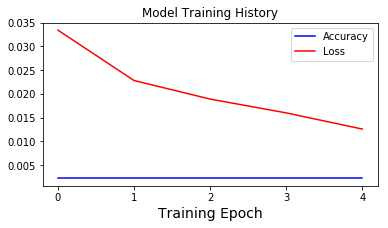

[io] Figure saved as results/model1/model1_keras_history  02-27-2020 11-53-55.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 3s 2ms/step
    - Accuracy:0.0022
    - Loss:0.0100
Evaluating Test Generator:
63/63 [==============================] - 0s 1ms/step
    - Accuracy:0.0000
    - Loss:0.0284


Metric,Value
R Squared,0.595
Root Mean Squared Error,0.013
Thiel's U,1.837


In [112]:
## FIT MODEL
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

## set params
epochs=5

# override keras warnings
ji.quiet_mode(True,True,True)

# Instantiating clock timer
clock = bs.Clock()
clock.tic('')

# Fit the model
history = model1.fit_generator(train_generator,
                               epochs=epochs,
                               verbose=2, 
                               use_multiprocessing=True,
                               workers=3)

clock.toc('')


model_key = "model_1"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model1,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [113]:
reload(ji)
## Get true vs pred data as a dataframe and iplot
df_model1 = ji.get_model_preds_df(model1, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  inverse_tf = True, 
                                  scaler = scaler_library['price'],
                                  preds_from_gen = True, 
                                  preds_from_train_preds = True, 
                                  preds_from_test_preds = True,
                                  iplot = True, iplot_title='Model 1: True Vs Predicted S&P 500 Price',
                                  verbose=0)
    
# Get evaluation metrics
df_results1, dfs_results1, df_shifted1 =\
ji.compare_eval_metrics_for_shifts(df_model1['true_test_price'],
                                   df_model1['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model1['true_train_price'],
                                   display_results=True,
                                   display_U_info=True,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)

[i] Using all columns...


<IPython.core.display.Latex object>

|Thiel's U Value | Interpretation |
    | --- | --- |
    | <1 | Forecasting is better than guessing| 
    | 1 | Forecasting is about as good as guessing| 
    |>1 | Forecasting is worse than guessing| 


Pred Shifted,R^2,RMSE,U
-4,0.5502,0.418,2.0752
-3,0.6184,0.3846,1.9011
-2,0.6217,0.3802,1.8484
-1,0.7419,0.3118,1.522
0,0.5948,0.3881,1.8415
1,0.4744,0.4333,2.0378
2,0.2795,0.4966,2.3167
3,0.163,0.5237,2.4269


In [114]:
save_model=True
# ji.save_model_dfs(file_dict, 'model_1',df_model1,dfs_results1,df_shifted1)

filename_prefix = file_dict['model_1']['base_filename']
if save_model ==True:
    model_1_output_files = ji.save_model_weights_params(model1,
                                 filename_prefix=filename_prefix,
                                 auto_increment_name=True,
                                 auto_filename_suffix=True, 
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

Model saved as models/stocks/model1___02-27-20_1154am.json
Weights saved as models/stocks/model1___02-27-20_1154am_weights.h5
ERROR:df_model_config = get_model_config_df(model)
<class 'pandas.core.frame.DataFrame'>


### Model 1 Summary

- Using Stock Price alone and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.95
    - RMSE value of 0.2693
    - Thiel's $U$ value of 0.4476
- This means our first model can explain 95% of the variance in the data ($R^2$) and that our model performed significantly better than guessing (Thiel's U value <1.0)

## Model 2: Stock Price + Technical Indicators

### Technical Indicator Details

In [115]:
# SELECT DESIRED COLUMNS
stock_df = stock_df[[
    'price','ma7','ma21','26ema','12ema','MACD','20sd',
    'upper_band','lower_band','ema','momentum']]

# Make stock_price for twitter functions
stock_df.dropna(inplace=True)
ji.index_report(stock_df)
display(stock_df.head(3))

------------------------------------------------------------
	INDEX REPORT:	
------------------------------------------------------------
* Index Endpoints:
	2016-12-29 15:30:00 -- to -- 2020-01-23 15:30:00
* Index Freq:
	<CustomBusinessHour: CBH=09:30-16:30>


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-12-29 15:30:00,94.63,95.206735,94.627007,94.920214,95.074533,0.154319,0.987375,96.601756,92.652257,94.623977,87.63
2016-12-30 09:30:00,94.72,95.191837,94.643333,94.917490,95.065938,0.148448,0.966569,96.576471,92.710196,94.687992,87.72
2016-12-30 10:30:00,94.55,95.173061,94.657483,94.912504,95.053438,0.140934,0.946264,96.550010,92.764955,94.595997,87.55


In [116]:
fig =ji.plotly_technical_indicators(stock_df,figsize=(900,500))

1. **7 and 21 day moving averages**
```python
df['ma7'] df['price'].rolling(window = 7 ).mean() #window of 7 if daily data
df['ma21'] df['price'].rolling(window = 21).mean() #window of 21 if daily data
```    
2. **MACD(Moving Average Convergence Divergence)**

> Moving Average Convergence Divergence (MACD) is a trend-following momentumindicator that shows the relationship between two moving averages of a security’s price. The MACD is calculated by subtracting the 26-period Exponential Moving Average (EMA) from the 12-period EMA.

>The result of that calculation is the MACD line. A nine-day EMA of the MACD, called the "signal line," is then plotted on top of the MACD line, which can function as a trigger for buy and sell signals. 

> Traders may buy the security when the MACD crosses above its signal line and sell - or short - the security when the MACD crosses below the signal line. Moving Average Convergence Divergence (MACD) indicators can be interpreted in several ways, but the more common methods are crossovers, divergences, and rapid rises/falls.  - _[from Investopedia](https://www.investopedia.com/terms/m/macd.asp)_

```python
df['ewma26'] = pd.ewma(df['price'], span=26)
df['ewma12'] = pd.ewma(df['price'], span=12)
df['MACD'] = (df['12ema']-df['26ema'])
```
3. **Exponentially weighted moving average**
```python
dataset['ema'] = dataset['price'].ewm(com=0.5).mean()
```

4. **Bollinger bands**
    > "Bollinger Bands® are a popular technical indicators used by traders in all markets, including stocks, futures and currencies. There are a number of uses for Bollinger Bands®, including determining overbought and oversold levels, as a trend following tool, and monitoring for breakouts. There are also some pitfalls of the indicators. In this article, we will address all these areas."
> Bollinger bands are composed of three lines. One of the more common calculations of Bollinger Bands uses a 20-day simple moving average (SMA) for the middle band. The upper band is calculated by taking the middle band and adding twice the daily standard deviation, the lower band is the same but subtracts twice the daily std. - _[from Investopedia](https://www.investopedia.com/trading/using-bollinger-bands-to-gauge-trends/)_

    - Boilinger Upper Band:<br>
    $BOLU = MA(TP, n) + m * \sigma[TP, n ]$<br><br>
    - Boilinger Lower Band<br>
    $ BOLD = MA(TP,n) - m * \sigma[TP, n ]$
    - Where:
        - $MA$  = moving average
        - $TP$ (typical price) = $(High + Low+Close)/ 3$
        - $n$ is number of days in smoothing period
        - $m$ is the number of standard deviations
        - $\sigma[TP, n]$ = Standard Deviations over last $n$ periods of $TP$

```python
# Create Bollinger Bands
dataset['20sd'] = pd.stats.moments.rolling_std(dataset['price'],20)
dataset['upper_band'] = dataset['ma21'] + (dataset['20sd']*2)
dataset['lower_band'] = dataset['ma21'] - (dataset['20sd']*2)
```


5. **Momentum**
> "Momentum is the rate of acceleration of a security's price or volume – that is, the speed at which the price is changing. Simply put, it refers to the rate of change on price movements for a particular asset and is usually defined as a rate. In technical analysis, momentum is considered an oscillator and is used to help identify trend lines." - _[from Investopedia](https://www.investopedia.com/articles/technical/081501.asp)_

    - $ Momentum = V - V_x$
    - Where:
        - $ V $ = Latest Price
        - $ V_x $ = Closing Price
        - $ x $ = number of days ago

```python
# Create Momentum
dataset['momentum'] = dataset['price']-1
```

In [117]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days=260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq( stock_df, ji.custom_BH_freq() )

## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(stock_df,
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

X_window size = 7 -- (1 day(s) * 7 rows/day)

training dates:	2018-12-28 09:30:00 	 2019-12-26 15:30:00 = 1820 rows
test dates:	2019-12-26 15:30:00 	 2020-01-23 14:30:00 = 140 rows


In [118]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens( 
    df_train['price'], df_test['price'], 
    x_window=x_window,n_features=1,batch_size=1, verbose=0)

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-12-28 09:30:00,98.74,96.191,102.146,101.508,98.2951,-3.21282,4.88862,111.923,92.3683,97.917,91.74
2018-12-28 10:30:00,98.07,96.1373,102.075,101.47,98.2898,-3.18055,4.86553,111.806,92.3438,98.019,91.07


[i] Using all columns...


,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2018-12-28 09:30:00,0.0512048,0.00741215,0.113914,0.0404328,0.00117084,0,1,0.286178,0.00243717,0.0194289,0.0512048
2018-12-28 10:30:00,0.0310241,0.00582469,0.111462,0.0390497,0.000998726,0.0064382,0.994537,0.281924,0.00166707,0.0225265,0.0310241


In [119]:
## Make new time series generators with all stock_indicators for X_sequences
train_generator, test_generator = ji.make_train_test_series_gens(
    train_data_series=df_train,
    test_data_series=df_test,
    y_cols='price',
    x_window=x_window,
    n_features=len(df_train.columns),
    batch_size=1, verbose=1)

Given the Array: 	(with shape=(1, 7, 11)) 
[5.12048193e-02 7.41214675e-03 1.13913665e-01 4.04327618e-02
 1.17084007e-03 0.00000000e+00 1.00000000e+00 2.86177568e-01
 2.43716918e-03 1.94289175e-02 5.12048193e-02 3.10240964e-02
 5.82469186e-03 1.11461627e-01 3.90496990e-02 9.98725599e-04
 6.43820105e-03 9.94536655e-01 2.81923616e-01 1.66707258e-03
 2.25265368e-02 3.10240964e-02 3.61445783e-02 4.43642334e-03
 1.09096825e-01 3.77501411e-02 9.60619555e-04 1.32466426e-02
 9.89105836e-01 2.77771232e-01 9.67273992e-04 2.69999050e-02
 3.61445783e-02 4.48795181e-02 2.93347176e-03 1.06757958e-01
 3.65814503e-02 1.14510433e-03 2.07125263e-02 9.82561658e-01
 2.73303660e-01 5.86059090e-04 3.43606763e-02 4.48795181e-02
 2.68072289e-02 1.22529787e-03 1.04263481e-01 3.51841576e-02
 8.66570617e-04 2.65744675e-02 9.76259183e-01 2.68747091e-01
 0.00000000e+00 2.46701662e-02 2.68072289e-02 4.90963855e-02
 2.41438005e-04 1.01886890e-01 3.40998310e-02 1.16029310e-03
 3.42538521e-02 9.67858446e-01 2.63668946e

In [120]:
# Create keras model from model_params
import functions_combined_BEST as ji
from keras.models import Sequential
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from IPython.display import display
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input = x_window 
n_features = len(df_train.columns) # Using stock_price and technical indicators

print(f'input shape: ({n_input},{n_features}')
input_shape=(n_input, n_features)

# Create model architecture
model2 = Sequential()
model2.add(LSTM(units=50, input_shape =input_shape,return_sequences=True))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
# model2.add(Dropout(0.2))
model2.add(LSTM(units=50, activation='relu'))
model2.add(Dense(1))

model2.compile(loss=ji.my_rmse, metrics=['acc',ji.my_rmse],
              optimizer=optimizers.Nadam())

display(model2.summary())

input shape: (7,11
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_5 (LSTM)                (None, 7, 50)             12400     
_________________________________________________________________
lstm_6 (LSTM)                (None, 50)                20200     
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 51        
Total params: 32,651
Trainable params: 32,651
Non-trainable params: 0
_________________________________________________________________


None

------------------------------------------------------------
	FITTING MODEL:
------------------------------------------------------------ 

--- CLOCK STARTED @:    02/27/20 - 11:54:10 AM           Label:            --- 
Epoch 1/5
1813/1813 [==============================] - 11s 6ms/step - loss: 0.0368 - acc: 0.0011 - my_rmse: 0.0368
Epoch 2/5
1813/1813 [==============================] - 10s 6ms/step - loss: 0.0225 - acc: 0.0011 - my_rmse: 0.0225
Epoch 3/5
1813/1813 [==============================] - 10s 6ms/step - loss: 0.0173 - acc: 0.0011 - my_rmse: 0.0173
Epoch 4/5
1813/1813 [==============================] - 10s 5ms/step - loss: 0.0138 - acc: 0.0011 - my_rmse: 0.0138
Epoch 5/5
1813/1813 [==============================] - 10s 6ms/step - loss: 0.0127 - acc: 0.0011 - my_rmse: 0.0127
--- TOTAL DURATION   =  0 min, 55.461 sec --- 


Lap #,Start Time,Duration,Label
TOTAL,02/27/20 - 11:54:10 AM,"0 min, 55.461 sec",


------------------------------------------------------------------------------------------
	TRAINING HISTORY:
------------------------------------------------------------------------------------------


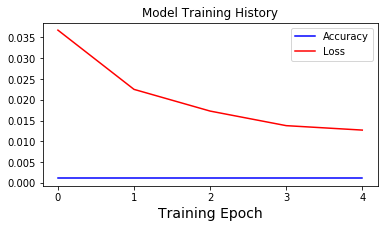

[io] Figure saved as results/model2/model2_keras_history  02-27-2020 11-55-06.png


------------------------------------------------------------------------------------------
	EVALUATE MODEL:
------------------------------------------------------------------------------------------
Evaluating Train Generator:
1813/1813 [==============================] - 3s 2ms/step
    - Accuracy:0.0011
    - Loss:0.0209
Evaluating Test Generator:
133/133 [==============================] - 0s 2ms/step
    - Accuracy:0.0075
    - Loss:0.0363


Metric,Value
R Squared,-0.005
Root Mean Squared Error,0.023
Thiel's U,3.363


In [121]:
epochs=5

clock = bs.Clock()
print('---'*20)
print('\tFITTING MODEL:')
print('---'*20,'\n')     

# start the timer
clock.tic('')

# Fit the model
history = model2.fit_generator(train_generator,epochs=epochs) 
clock.toc('')

model_key = "model_2"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model2,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [122]:
## Get true vs pred data as a dataframe and iplot
df_model2 = ji.get_model_preds_df(model2, 
                                  test_generator=test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  x_window=x_window,
                                  n_features=len(df_train.columns),
                                  scaler=scaler_library['price'],
                                  preds_from_gen=True, 
                                  inverse_tf=True,
                                  iplot=True,  iplot_title='Model 2: True Vs Predicted S&P 500 Price')

# Compare predictions if predictions timebins shifted
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

[i] Using all columns...


,true_train_price,true_test_price,pred_from_gen
2018-12-28 09:30:00,98.74,nan,nan
2018-12-28 10:30:00,98.07,nan,nan
2018-12-28 11:30:00,98.24,nan,nan


,true_train_price,true_test_price,pred_from_gen
2020-01-23 12:30:00,nan,130.8,129.701
2020-01-23 13:30:00,nan,130.8,130.303
2020-01-23 14:30:00,nan,131.28,130.076


Pred Shifted,R^2,RMSE,U
-4,-0.0549,0.8045,3.5208
-3,-0.0458,0.7979,3.4648
-2,-0.0369,0.7924,3.46
-1,0.1049,0.7342,3.2151
0,-0.0047,0.7789,3.3705
1,-0.0602,0.8031,3.4606
2,-0.1257,0.8307,3.6696
3,-0.1738,0.8492,3.7395
4,-0.1974,0.8594,3.7763


In [123]:
# ##SAVING DFS
# ji.save_model_dfs(file_dict,'model_2',
#                df_model=df_model2,
#               df_results=dfs_results2,
#               df_shifted=df_shifted2)

In [124]:
df_results2, dfs_results2, df_shifted2 =\
ji.compare_eval_metrics_for_shifts(df_model2['true_test_price'],
                                   df_model2['pred_from_gen'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_model2['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)

Pred Shifted,R^2,RMSE,U
-4,-0.0549,0.8045,3.5208
-3,-0.0458,0.7979,3.4648
-2,-0.0369,0.7924,3.46
-1,0.1049,0.7342,3.2151
0,-0.0047,0.7789,3.3705
1,-0.0602,0.8031,3.4606
2,-0.1257,0.8307,3.6696
3,-0.1738,0.8492,3.7395
4,-0.1974,0.8594,3.7763


### Model 2: Summary

- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.98
    - RMSE value of 0.269
    - Thiel's $U$ value of 0.4812
- This means our second model can explain \_\_% of the variance in the data ($R^2$) and that our model performed ~~significantly better~~ than guessing (Thiel's U value ~~<1.0~~)

- It is surprisng that the model's performance is so poor by adding the technical indicators.
    - Further investigation is required to understand why the $R^2$ value is negative. 

# COMBINING TWEET STATS, NLP CLASSIFICATION, AND MARKET DATA

In [125]:
# # LOAD IN FULL STOCK DATASET using ClosingBig S&P500 WITH INDEX.FREQ=CBH
# # fname = file_dict['stock_df']['stock_df_with_indicators']
# full_df = ji.load_processed_stock_data(processed_data_filename=fname)

# # SELECT DESIRED COLUMNS
# stock_df = full_df[[
#     'price','ma7','ma21','26ema','12ema','MACD',
#     '20sd','upper_band','lower_band','ema','momentum'
# ]]

# stock_df.head()

# stock_df['date_time'] = stock_df.index.to_series()
# ji.index_report(stock_df)

# stock_df.sort_index(inplace=True)
# display(stock_df.head(2),stock_df.tail(2))
# del full_df
stock_df.head()

,price,ma7,ma21,26ema,12ema,MACD,20sd,upper_band,lower_band,ema,momentum
date_time_index,,,,,,,,,,,
2016-12-29 15:30:00,94.63,95.206735,94.627007,94.920214,95.074533,0.154319,0.987375,96.601756,92.652257,94.623977,87.63
2016-12-30 09:30:00,94.72,95.191837,94.643333,94.917490,95.065938,0.148448,0.966569,96.576471,92.710196,94.687992,87.72
2016-12-30 10:30:00,94.55,95.173061,94.657483,94.912504,95.053438,0.140934,0.946264,96.550010,92.764955,94.595997,87.55
2016-12-30 11:30:00,94.68,95.155510,94.672109,94.909358,95.044398,0.135040,0.925274,96.522656,92.821562,94.651999,87.68
2016-12-30 12:30:00,94.60,95.135918,94.685918,94.905183,95.033646,0.128463,0.900092,96.486102,92.885734,94.617333,87.60


# BOOKMARK 022720- Error merging dfs

In [129]:
## LOAD IN RAW TWITTER DATA, NO PROCESSING
# from functions_combined_BEST import ihelp_menu2
# # file_dict = ji.load_filename_directory()
raw_tweets = 'data/trump_tweets_12012016_to_01012020.csv'
sp500 = 'data/SP500_1min_01_23_2020.xlsx'
# dft = pd.read_csv(tweets)
# dfs = pd.read_excel(sp500)
np.random.seed(42)

twitter_df= ji.load_raw_twitter_file(filename= raw_tweets,#'data/trump_tweets_12012016_to_01012020.csv'

                                     date_as_index=True,
                                     rename_map={'text': 'content', 'created_at': 'date_time_index'})
twitter_df = ji.check_twitter_df(twitter_df,text_col='content',remove_duplicates=True, remove_long_strings=True)


[io] Loading raw tweet text file: data/trump_tweets_12012016_to_01012020.csv


KeyError: 'date'

In [130]:
# MAKE TIME INTERVALS BASED ON BUSINESS HOUR START (09:30-10:30)
time_intervals= \
ji.make_time_index_intervals(stock_df.reset_index(drop=True),
                             col='date_time_index', 
                             closed='right',
                             return_interval_dicts=False) 
time_intervals

KeyError: 'date_time_index'

In [ ]:
## USE THE TIME INDEX TO FILTER OUT TWEETS FROM THE HOUR PRIOR
twitter_df, bin_codes = ji.bin_df_by_date_intervals(twitter_df ,time_intervals)
stock_df, bin_codes_stock = ji.bin_df_by_date_intervals(stock_df.reset_index(drop=True), time_intervals, column='date_time_index')
stock_df

In [ ]:
## COLLAPSE DFs BY CODED BINS
twitter_grouped = ji.collapse_df_by_group_index_col(twitter_df,
                                                    group_index_col='int_bins',
                                                    drop_orig=True,
                                                    verbose=0)

stocks_grouped = ji.collapse_df_by_group_index_col(stock_df,
                                                    drop_orig=True,
                                                    group_index_col='int_bins', 
                                                  verbose=0)
display(twitter_grouped.head(2),stocks_grouped.head(2))

In [ ]:
# 022720
stocks_grouped

In [ ]:
ihelp_menu(ji.merge_stocks_and_tweets)

In [ ]:
## STOCKS AND TWEETS 
stocks_grouped['date_time'] = stocks_grouped.index.to_series()
df_combined = ji.merge_stocks_and_tweets(stocks_grouped, 
                                      twitter_grouped,
                                      on='int_bins',how='left',
                                      show_summary=False)

In [ ]:
ji.column_report(df_combined, as_df=True)

In [ ]:
## Check for and address new null values
ji.check_null_small(df_combined);
cols_to_fill_zeros = ['num_tweets','total_retweet_count','total_favorite_count']
for col in cols_to_fill_zeros:
    idx_null = ji.find_null_idx(df_combined, column=col)
    df_combined.loc[idx_null,col] = 0

cols_to_fill_blank_str = ['group_content','source','tweet_times','is_retweet']
for col in cols_to_fill_blank_str:
    idx_null = ji.find_null_idx(df_combined, column=col)
    df_combined.loc[idx_null, col] = ""
ji.check_null_small(df_combined);

In [ ]:
fname = file_dict['df_combined']['pre_nlp']
df_combined.to_csv(fname)
df_combined

In [ ]:
## Add nlp
df_nlp = ji.full_twitter_df_processing(df_combined,'group_content',force=True)
ji.column_report(df_nlp, as_df=True)

In [ ]:
## Use case ratio null values as index to replace values
idx_null= ji.check_null_small(df_nlp,null_index_column='case_ratio')
df_nlp.loc[idx_null,'case_ratio'] = 0.0
ji.check_null_small(df_nlp)

## replace sentiment_class, set =-1
cols_to_replace_misleading_values = ['sentiment_class']
for col in cols_to_replace_misleading_values:
    df_nlp.loc[idx_null,col] = -1

## remap sentiment class
sent_class_mapper = {'neg':0, -1:1, 'pos':2}
df_nlp['sentiment_class'] = df_nlp['sentiment_class'].apply(lambda x: sent_class_mapper[x])

bool_cols_to_ints = ['has_tweets']
for col in bool_cols_to_ints:
    df_nlp[col] = df_nlp[col].apply(lambda x: 1 if x==True else 0)    

In [ ]:
df_nlp#.head(10)

In [ ]:
ji.display_same_tweet_diff_cols(df_nlp.groupby('has_tweets').get_group(True),
                                columns=['group_content','content_min_clean',
                                         'cleaned_stopped_lemmas'],as_md=True)

In [ ]:
ji.check_twitter_df(df_nlp,char_limit=61*350)
# get_floats = df_nlp['content_min_clean'].apply(lambda x: isinstance(x,float))

In [ ]:
fname =file_dict['df_combined']['post_nlp']
df_nlp.to_csv(fname)
# print(f'saved to {fname}')

### Loading in NLP Model for Predictions

In [ ]:
def get_most_recent_filenames(full_filename,str_to_find=None):
    import os
    import time
    fparts = full_filename.split('/')
    folder = '/'.join(fparts[0:-1])
    name = fparts[-1]
    
    filelist = os.listdir(folder)

    mtimes = [['file','date modified']]
    for file in filelist:
        if str_to_find is None:
            mtimes.append([file, time.ctime(os.path.getmtime(folder+'/'+file))])
        elif str_to_find in file:
            mtimes.append([file, time.ctime(os.path.getmtime(folder+'/'+file))])
    res = bs.list2df(mtimes)
    res['date modified'] = pd.to_datetime(res['date modified'])
    res.set_index('date modified',inplace=True)
    res.sort_index(ascending=False, inplace=True)
    
    most_recent = res.iloc[0]
    import re
    re.compile(r'()')
    
    return    res

In [ ]:
## Load the nlp model and weights with layers set trainable=False
base_fname = file_dict['nlp_model_for_predictions']['base_filename']
nlp_model,df_model_layers =  ji.load_model_weights_params(base_filename= base_fname,#'models/NLP/nlp_model0B__09-02-2019_0121pm',
                                        load_model_params=False,
                                        load_model_layers_excel=True,
                                        trainable=False)
## Load in Word2Vec model from earlier
w2v_model = io.load_word2vec(file_dict=file_dict)

### Get Predictions for Hour-Binned Tweets

In [ ]:
ihelp_menu([ji.get_tokenizer_and_text_sequences,
           ji.replace_embedding_layer])

In [ ]:
## GET X_SEQUENES FOR BINNED TWEETS AND CREATE NEW EMBEDDING LAYER FOR THEIR SIZE
text_data=df_nlp['cleaned_stopped_lemmas']
tokenizer, X_sequences = ji.get_tokenizer_and_text_sequences(w2v_model,text_data)

new_nlp_model = ji.replace_embedding_layer(nlp_model,w2v_model,text_data,verbose=2)
new_nlp_model.summary()

In [ ]:
## GET PREDICTIONS FROM NEW MODEL
preds = new_nlp_model.predict_classes(X_sequences)
print(type(preds), preds.shape)
ji.check_y_class_balance(preds)

In [ ]:
## add to df
df_nlp['pred_classes_int'] = preds
mapper= {0:'neg',  1:'no_change', 2:'pos'}
df_nlp['pred_classes'] = df_nlp['pred_classes_int'].apply(lambda x: mapper[x])
display(df_nlp.head())

## Model 3: Stock Price + Indicators + NLP Preds & Tweet Features

### Finalize colums for final model

In [ ]:
df_combined = df_nlp

model_col_list = ['price', 'ma7', 'ma21', '26ema', '12ema', 'MACD', '20sd', 'upper_band','lower_band', 'ema', 'momentum',
                  'has_tweets','num_tweets','case_ratio', 'compound_score','pos','neu','neg','sentiment_class',
                  'pred_classes','pred_classes_int','total_favorite_count','total_retweet_count']

df_combined = ji.set_timeindex_freq(df_combined,fill_nulls=False)

df_to_model = df_combined[model_col_list].copy()
df_to_model.head(2)

In [ ]:
## SPECIFY # OF TRAINING TEST DAYS 
num_test_days=20
num_train_days=260
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=2

cols_to_exclude = ['pred_classes','has_tweets']
# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq(df_to_model.drop(cols_to_exclude,axis=1), ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(df_to_model.drop(cols_to_exclude,axis=1),
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

In [ ]:
###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))

# Show transformed dataset
# display( df_train.head(2).round(3).style.set_caption('training data - scaled'))

# Create timeseries generators
train_generator, test_generator = ji.make_train_test_series_gens(
    train_data_series=df_train,
    test_data_series=df_test,
    y_cols='price',
    x_window=x_window,
    n_features=len(df_train.columns),
    batch_size=1, verbose=1)

In [ ]:
from keras.models import Sequential
from keras import optimizers
from keras.layers import Bidirectional, Dense, LSTM, Dropout
from IPython.display import display
from keras.regularizers import l2

# Specifying input shape (size of samples, rank of samples?)
n_input =x_window
n_features = len(df_train.columns)
print(f'input shape: ({n_input},{n_features})')
input_shape=(n_input, n_features)

# Create model architecture
model3 = Sequential()
model3.add(LSTM(units=100, input_shape =input_shape,return_sequences=True,dropout=0.3,recurrent_dropout=0.3))#,  kernel_regularizer=l2(0.01),recurrent_regularizer=l2(0.01),
model3.add(LSTM(units=100, activation='relu', return_sequences=False,dropout=0.3,recurrent_dropout=0.3))
model3.add(Dense(1))

model3.compile(loss=ji.my_rmse, metrics=['acc'],optimizer=optimizers.Nadam())
    
model3.summary()

In [ ]:
## FIT MODEL
dashes = '---'*20
print(f"{dashes}\n\tFITTING MODEL:\n{dashes}")

## set params
epochs=5

# override keras warnings
ji.quiet_mode(True,True,True)

# Instantiating clock timer
clock = bs.Clock()
clock.tic('')

# Fit the model
history = model3.fit_generator(train_generator,
                               epochs=epochs,
                               verbose=2, 
                               use_multiprocessing=True,
                               workers=3)
clock.toc('')

model_key = "model_3"
hist_fname = file_dict[model_key]['fig_keras_history.ext']
summary_fname = file_dict[model_key]['model_summary']

# eval_results = ji.evaluate_model_plot_history(model1, train_generator, test_generator)
ji.evaluate_regression_model(model3,history,
                             train_generator=train_generator,
                             test_generator=test_generator,
                            true_test_series=df_test['price'],
                            true_train_series =df_train['price'],
                             save_history=True,history_filename=hist_fname,
                             save_summary=True, summary_filename=summary_fname)

In [ ]:
### PREFER NEW WAY - GET DF_MODEL FIRST THEN GET EVALUATE_REGRESSION INFORMATION?
## Get true vs pred data as a dataframe and iplot
df_model3 = ji.get_model_preds_df(model3, 
                                  test_generator = test_generator,
                                  true_train_series = df_train['price'],
                                  true_test_series = df_test['price'],
                                  include_train_data=True,
                                  inverse_tf = True, 
                                  scaler = scaler_library['price'],
                                  preds_from_gen = True, 
                                  iplot = False,
                                  verbose=1)

ji.plotly_true_vs_preds_subplots(df_model3,title='Model 3: True Vs Predicted S&P 500 Price')
    
# Get evaluation metrics
df_results3, dfs_results3, df_shifted3 =\
ji.compare_eval_metrics_for_shifts(df_model3['true_test_price'],
                                   df_model3['pred_from_gen'],
                                   shift_list=np.arange(-4,4,1),
                                   true_train_series_to_add=df_model3['true_train_price'],
                                   display_results=True,
                                   display_U_info=True,
                                   return_results=True,
                                   return_styled_df=True,
                                   return_shifted_df=True)


save_model=True
ji.save_model_dfs(file_dict, 'model_3',df_model3,dfs_results3,df_shifted3)

In [ ]:
filename_prefix = file_dict['model_3']['base_filename']
if save_model ==True:
    model_3_output_files = bs.save_model_weights_params(model3,
                                 filename_prefix=filename_prefix,
                                 auto_increment_name=True,
                                 auto_filename_suffix=True, 
                                 suffix_time_format='%m-%d-%y_%I%M%p',
                                 save_model_layer_config_xlsx=True)

### Model 3 Summary

- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 
    - RMSE value of 
    - Thiel's $U$ value of 
- This means our second model can explain \_\_% of the variance in the data ($R^2$) and that our model performed ~~significantly better~~ than guessing (Thiel's U value ~~<1.0~~)

- It is surprisng that the model's performance is so poor by adding the technical indicators.
    - Further investigation is required to understand why the $R^2$ value is negative. 

## Model X: XGB Regression + Feature Importance


In [ ]:
## SPECIFY # OF TRAINING TEST DAYS 
reload(ji)
num_test_days=20
num_train_days=2*52*5
### SPECIFY Number of days included in each X_sequence (each prediction)
days_for_x_window=1

cols_to_exclude = ['pred_classes','has_tweets']
# Calculate number of rows to bin for x_windows
periods_per_day = ji.get_day_window_size_from_freq(df_to_model.drop(cols_to_exclude,axis=1), ji.custom_BH_freq() )


## Get the number of rows for x_window 
x_window = periods_per_day * days_for_x_window#data_params['days_for_x_window'] 
print(f'X_window size = {x_window} -- ({days_for_x_window} day(s) * {periods_per_day} rows/day)\n')

## Train-test-split by the # of days
df_train, df_test = ji.train_test_split_by_last_days(df_to_model.drop(cols_to_exclude,axis=1),
                                                     periods_per_day =periods_per_day, 
                                                     num_test_days   = num_test_days,
                                                     num_train_days  = num_train_days,
                                                     verbose=1, iplot=True)

###### RESCALE DATA USING MinMaxScalers FIT ON TRAINING DATA's COLUMNS ######
display(df_train.head(2).style.set_caption('df_train - pre-scaling'))

scaler_library, df_train = ji.make_scaler_library(df_train, transform=True, verbose=1)

df_test = ji.transform_cols_from_library(df_test, col_list=None,
                                         scaler_library=scaler_library,
                                         inverse=False)
display(df_train.head(2).style.set_caption('df_train - post-scaling'))


In [ ]:
## Shift price values such that the y-value being predicted is the following hour's Closing Price
df_train['price_shifted'] = df_train['price'].shift(-1)
df_test['price_shifted'] = df_test['price'].shift(-1)

display(df_train[['price','price_shifted','momentum','ema','num_tweets',]].head(10))

# Drop the couple of null values created by the shift
df_train.dropna(subset=['price_shifted'], inplace=True)
df_test.dropna(subset=['price_shifted'], inplace=True)

## Drop columns and make train-test-X and y
target_col = 'price_shifted'
drop_cols = ['price_shifted','price']

X_train = df_train.drop(drop_cols,axis=1)
y_train = df_train[target_col]
X_test = df_test.drop(drop_cols,axis=1)
y_test = df_test[target_col]

In [ ]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
clock = bs.Clock()
clock.tic('')
reg = xgb.XGBRegressor(n_estimators=1000,silent=False,max_depth=4)

reg.fit(X_train, y_train,
        eval_set=[(X_train, y_train), (X_test, y_test)],
        early_stopping_rounds=50,
       verbose=False)


## Get Predictions
pred_price = reg.predict(X_test)
pred_price_series = pd.Series(pred_price,index=df_test.index,name='pred_test_price')#.plot()
df_xgb = pd.concat([df_train['price'].rename('true_train_price'), pred_price_series,df_test['price'].rename('true_test_price')],axis=1)


df_results = ji.evaluate_regression(df_test['price'], pred_price_series,show_results=True);

clock.toc('')
fig = ji.plotly_true_vs_preds_subplots(df_xgb,true_train_col='true_train_price',
                                true_test_col='true_test_price',
                                pred_test_columns='pred_test_price',
                                      title='Model X: True Vs Predicted S&P 500 Price')


## PLOT FEATURE IMPORTANCE
feature_importance={}
for import_type in ['weight','gain','cover']:
    reg.importance_type = import_type
    cur_importances = reg.feature_importances_
    feature_importance[import_type] = pd.Series(data = cur_importances,
                                               index=df_train.drop(drop_cols,axis=1).columns,
                                               name=import_type)

df_importance = pd.DataFrame(feature_importance)

In [ ]:
    
importance_fig = df_importance.sort_values(by='weight', ascending=True).iplot(kind='barh',theme='solar',
                                                                    title='Feature Importance',
                                                                    xTitle='Relative Importance<br>(sum=1.0)',
                                                                    asFigure=True,dimensions=(1000, 600))

iplot(importance_fig)

In [ ]:
# ihelp(df_importance.iplot)

In [ ]:
  
importance_fig = df_importance.sort_values(by='weight', ascending=True).iplot(kind='barh',theme='solar',
                                                                    title='Feature Importance',
                                                                    xTitle='Relative Importance<br>(sum=1.0)',
                                                                    asFigure=True)

iplot(importance_fig)

In [ ]:
# Compare predictions if predictions timebins shifted
df_resultsX, dfs_resultsX, df_shiftedX =\
ji.compare_eval_metrics_for_shifts(df_xgb['true_test_price'],
                                   df_xgb['pred_test_price'],
                                   shift_list=np.arange(-4,5,1),
                                   true_train_series_to_add=df_xgb['true_train_price'],
                                   display_results=True,
                                   return_styled_df=True,
                                   display_U_info=False,
                                   return_shifted_df=True,
                                   return_results=True)
df_importance.to_csv('results/modelxgb/df_importance.csv')

ji.save_model_dfs(file_dict, 'model_xgb',df_xgb,dfs_resultsX,df_shiftedX)

In [ ]:
tree_vis = xgb.to_graphviz(reg)
tree_vis.render("xgb_full_model_",format="png",)

### Model X Summary

- **XGBRegressor blows all neural networks out of the water, without requiring a time-shift.**
- Using Stock Price plus technical indicators, and with a prediction time-shift of -1, we achieved:
    - $R^2$ value of 0.99
    - RMSE value of 0.0077
    - Thiel's $U$ value of 0.33
    
    0.0077	0.3254
- This means our second model can explain 98% of the variance in the data ($R^2$) and that our model performed remarkably  better than guessing (Thiel's U value).

- It is surprisng how good the XGB results are in comparison to prior models. 
    - The model is extremely fast and very accurate.
    

# Summary

In [ ]:
dfs_list = {'Model 1':dfs_results1,
            'Model 2':dfs_results2,
            'Model 3':dfs_results3,
            'XGB Regressor':dfs_resultsX}
for k,v in dfs_list.items():
    new_cap = f'Evaluation Metrics for {k}'
    display(v.set_caption(new_cap))